## Assignment 3
### Harsh Gupta
### 12140750

# Q1


In [20]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from torch.utils.data import DataLoader, Dataset
import torchvision
from torch.autograd import grad
from torchvision import transforms
import torch.nn as nn
import torch.nn.functional as F
import cv2
import seaborn as sns
import json
from PIL import Image
import torch.optim as optim
from sklearn.preprocessing import StandardScaler

In [22]:
import os
os.listdir('/kaggle/input/')

['facerecog',
 'imagesforq3',
 'price-volume-data-for-all-us-stocks-etfs',
 'modelauto',
 'svmoutlier',
 'personal',
 'train-test-combine']

In [23]:
def Initial(stockname):
    df_st1 = pd.read_csv(f'/kaggle/input/price-volume-data-for-all-us-stocks-etfs/Stocks/{stockname}')
    print(df_st1)
    df_st1['Date'] = pd.to_datetime(df_st1['Date'])
    df2_st1 = df_st1.set_index('Date')
    plt.figure(figsize = (12, 12))
    plt.plot(df2_st1['High'], label = 'High')
    plt.plot(df2_st1['Low'], label = 'Low')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.show()
    plt.figure(figsize = (12, 12))
    plt.plot(df2_st1['Close'], label = 'close')
    plt.plot(df2_st1['Open'], label = 'open')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.legend()
    plt.show()
    df3_st1 = df_st1.iloc[:, 1:]
    df3_st1 =  df3_st1.drop('OpenInt', axis = 1)
    print(df3_st1)
    return df2_st1, df3_st1

Loading stock file and visualizng their feature like open, close, high, low

            Date     Open     High      Low    Close  Volume  OpenInt
0     2005-02-25   2.7985   2.8152   2.7679   2.7958   47033        0
1     2005-02-28   2.7595   2.8540   2.7486   2.8540   58791        0
2     2005-03-01   2.8540   2.8540   2.7541   2.8095   88448        0
3     2005-03-02   2.8124   2.8485   2.7595   2.8235  130879        0
4     2005-03-03   2.7875   2.8540   2.7541   2.8317  117092        0
...          ...      ...      ...      ...      ...     ...      ...
3196  2017-11-06  34.5000  34.7500  34.2500  34.6500  107802        0
3197  2017-11-07  34.6500  34.7500  34.4000  34.6000  180383        0
3198  2017-11-08  34.5000  35.2500  34.1000  34.4250  102899        0
3199  2017-11-09  34.1500  34.5000  33.3000  33.3500  150974        0
3200  2017-11-10  33.2500  34.1500  33.2500  33.8000  134502        0

[3201 rows x 7 columns]


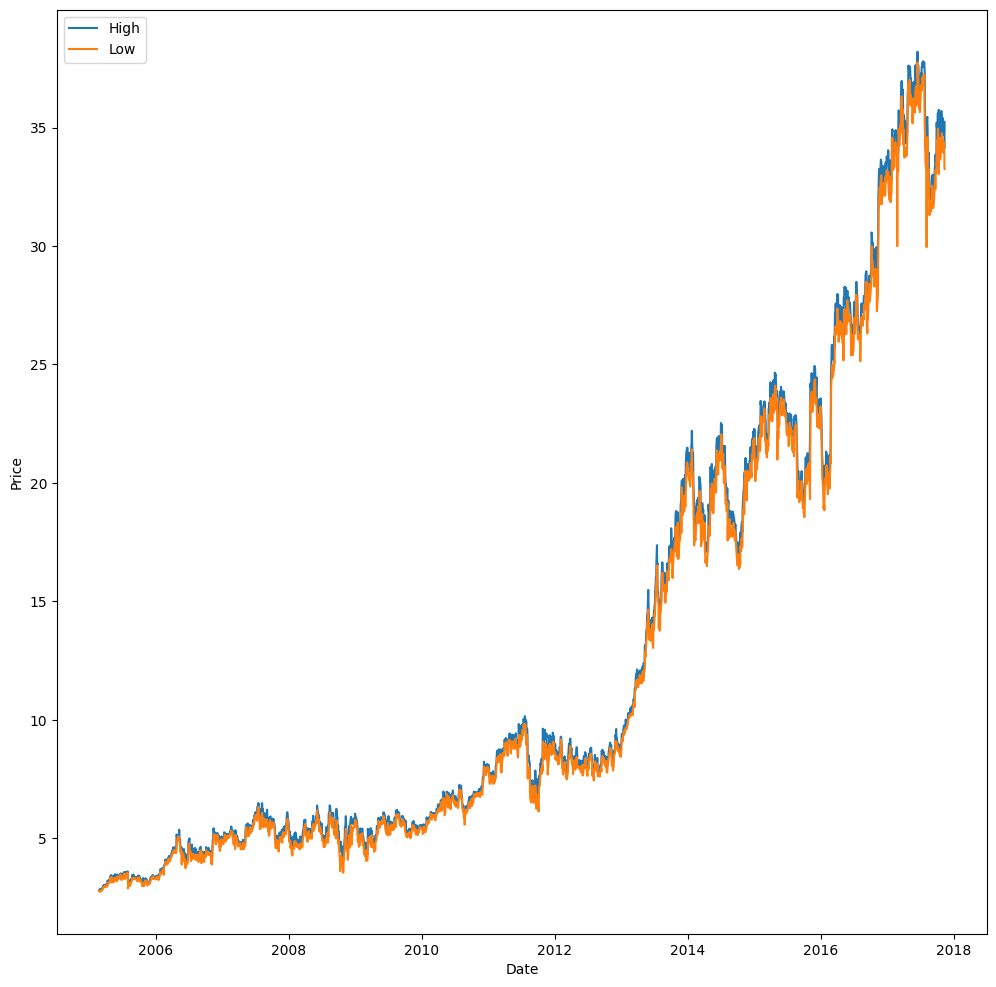

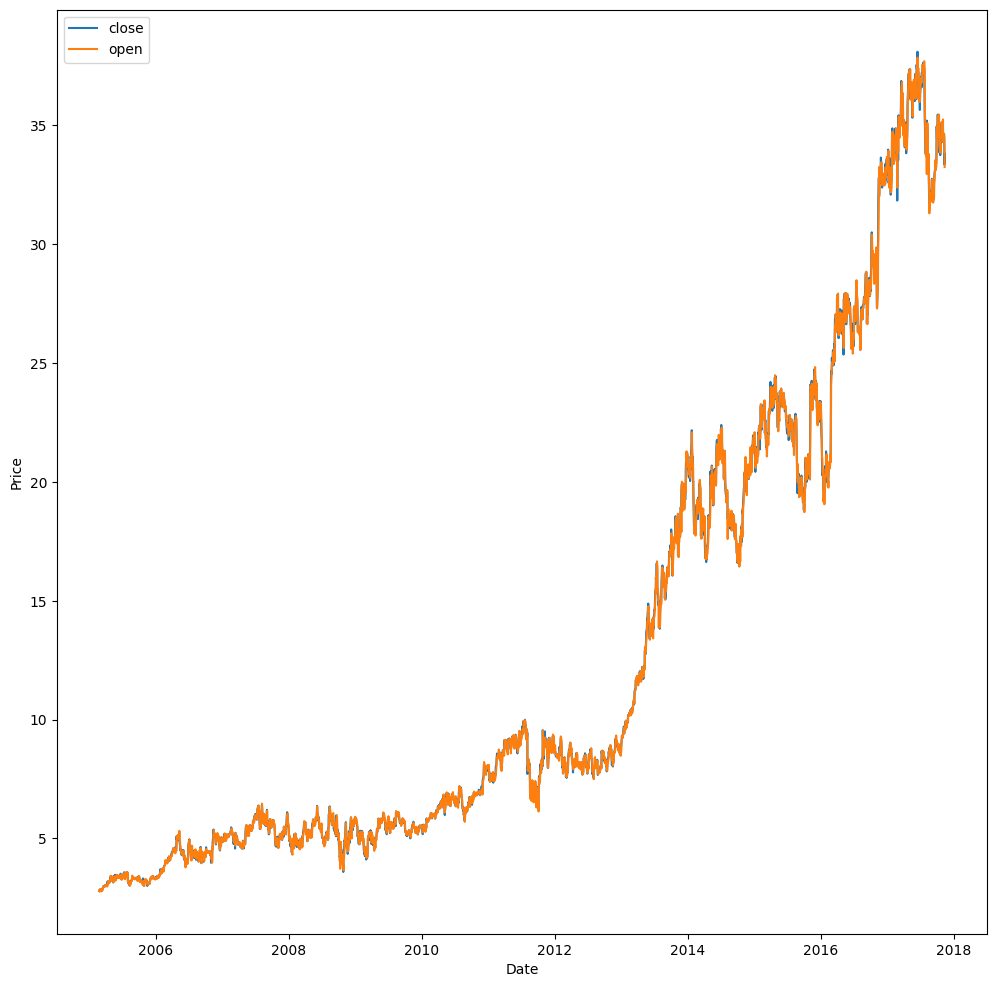

         Open     High      Low    Close  Volume
0      2.7985   2.8152   2.7679   2.7958   47033
1      2.7595   2.8540   2.7486   2.8540   58791
2      2.8540   2.8540   2.7541   2.8095   88448
3      2.8124   2.8485   2.7595   2.8235  130879
4      2.7875   2.8540   2.7541   2.8317  117092
...       ...      ...      ...      ...     ...
3196  34.5000  34.7500  34.2500  34.6500  107802
3197  34.6500  34.7500  34.4000  34.6000  180383
3198  34.5000  35.2500  34.1000  34.4250  102899
3199  34.1500  34.5000  33.3000  33.3500  150974
3200  33.2500  34.1500  33.2500  33.8000  134502

[3201 rows x 5 columns]


In [24]:
st1_1, st1_2 = Initial("aaon.us.txt")

            Date    Open    High     Low   Close  Volume  OpenInt
0     2005-02-25  16.686  17.412  16.587  17.365   54991        0
1     2005-02-28  17.074  17.211  16.705  16.937   42870        0
2     2005-03-01  17.220  17.402  17.162  17.402   16751        0
3     2005-03-02  16.985  17.665  16.985  17.422   26016        0
4     2005-03-03  17.560  17.579  17.355  17.550   15486        0
...          ...     ...     ...     ...     ...     ...      ...
3196  2017-11-06  48.150  48.450  47.755  47.900   69296        0
3197  2017-11-07  47.800  48.050  46.650  46.650  160746        0
3198  2017-11-08  46.650  47.450  45.950  46.500  147688        0
3199  2017-11-09  46.150  46.550  45.300  45.750  100978        0
3200  2017-11-10  45.750  46.300  45.550  45.800  110322        0

[3201 rows x 7 columns]


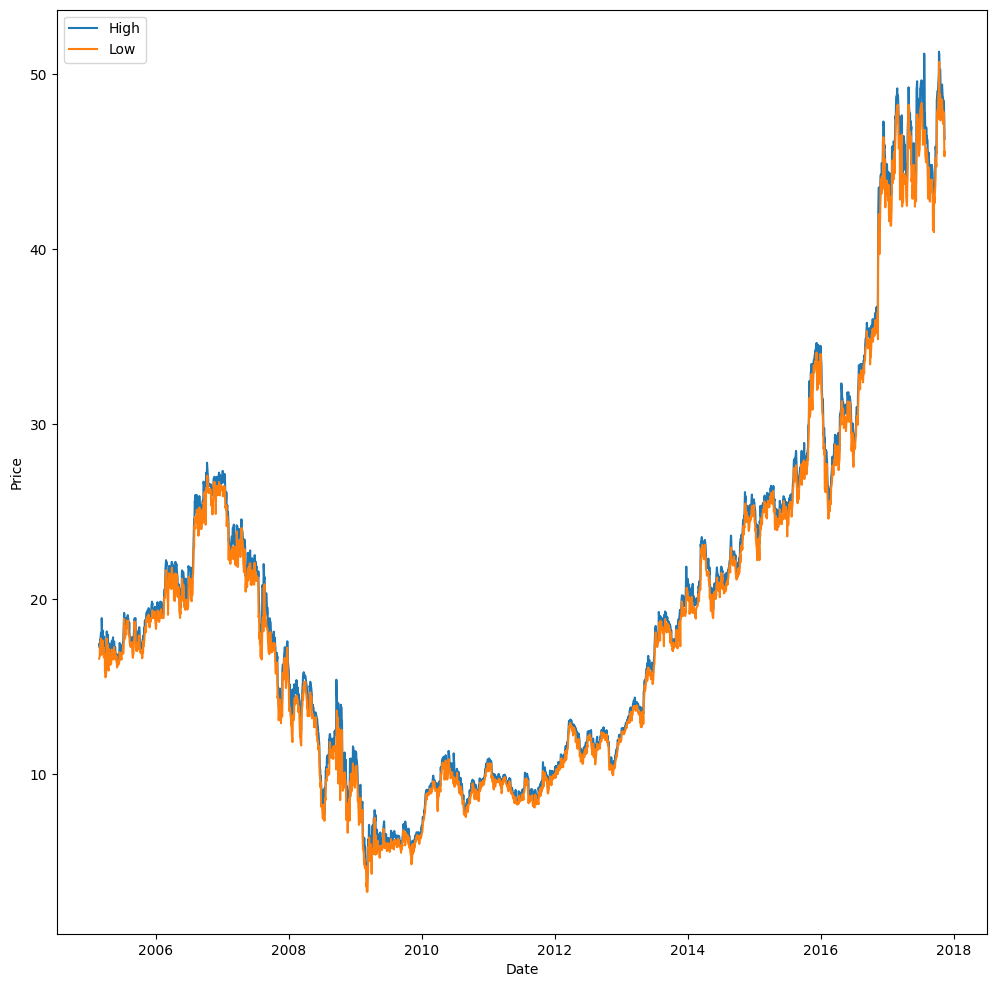

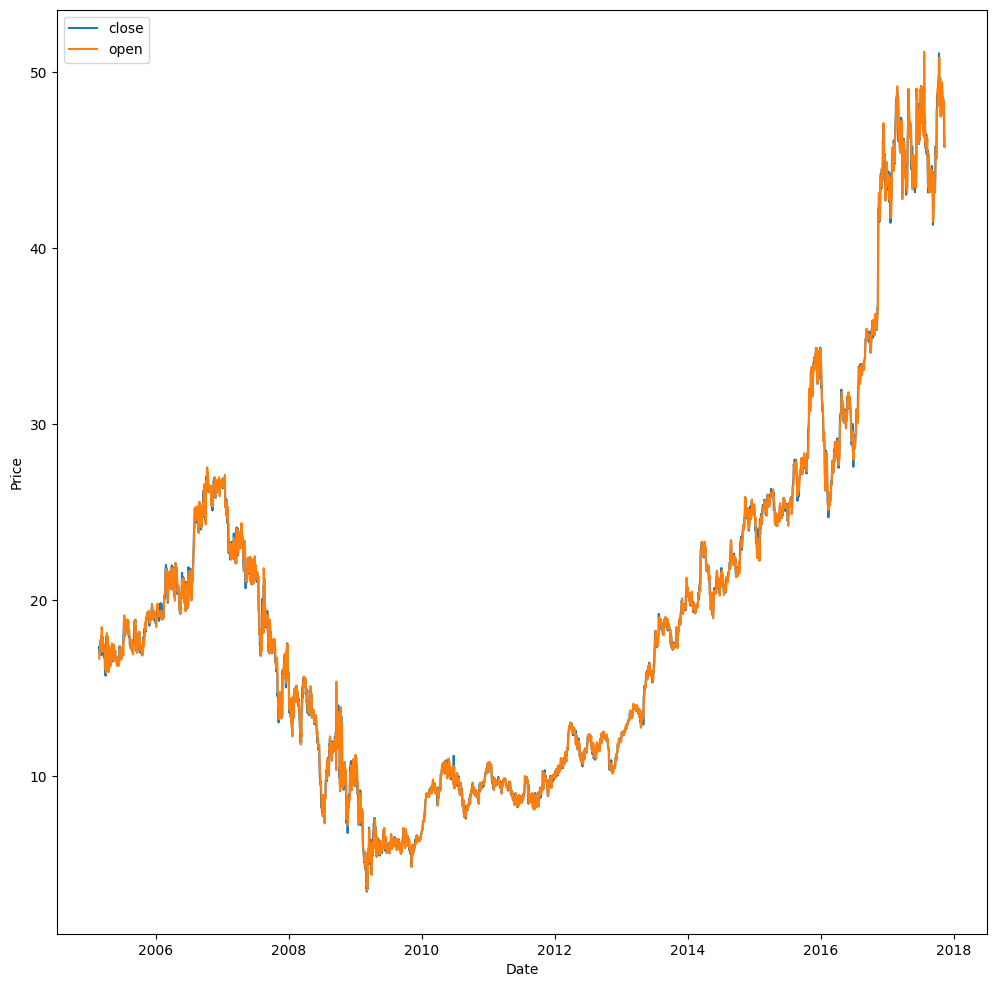

        Open    High     Low   Close  Volume
0     16.686  17.412  16.587  17.365   54991
1     17.074  17.211  16.705  16.937   42870
2     17.220  17.402  17.162  17.402   16751
3     16.985  17.665  16.985  17.422   26016
4     17.560  17.579  17.355  17.550   15486
...      ...     ...     ...     ...     ...
3196  48.150  48.450  47.755  47.900   69296
3197  47.800  48.050  46.650  46.650  160746
3198  46.650  47.450  45.950  46.500  147688
3199  46.150  46.550  45.300  45.750  100978
3200  45.750  46.300  45.550  45.800  110322

[3201 rows x 5 columns]


In [25]:
st2_1, st2_2 = Initial("abcb.us.txt")

            Date    Open    High     Low   Close   Volume  OpenInt
0     2005-02-25  19.730  19.730  19.305  19.700   176690        0
1     2005-02-28  19.815  20.140  19.385  20.015   280416        0
2     2005-03-01  19.800  20.215  19.765  19.905   285522        0
3     2005-03-02  19.500  19.625  19.400  19.560   938764        0
4     2005-03-03  19.600  19.770  19.125  19.595   689216        0
...          ...     ...     ...     ...     ...      ...      ...
3196  2017-11-06  53.700  53.700  53.050  53.150  1330652        0
3197  2017-11-07  53.150  53.525  53.150  53.400  1081833        0
3198  2017-11-08  53.400  53.550  53.100  53.450   998886        0
3199  2017-11-09  53.200  53.350  52.800  52.850  1777744        0
3200  2017-11-10  53.400  53.525  53.225  53.400  4990261        0

[3201 rows x 7 columns]


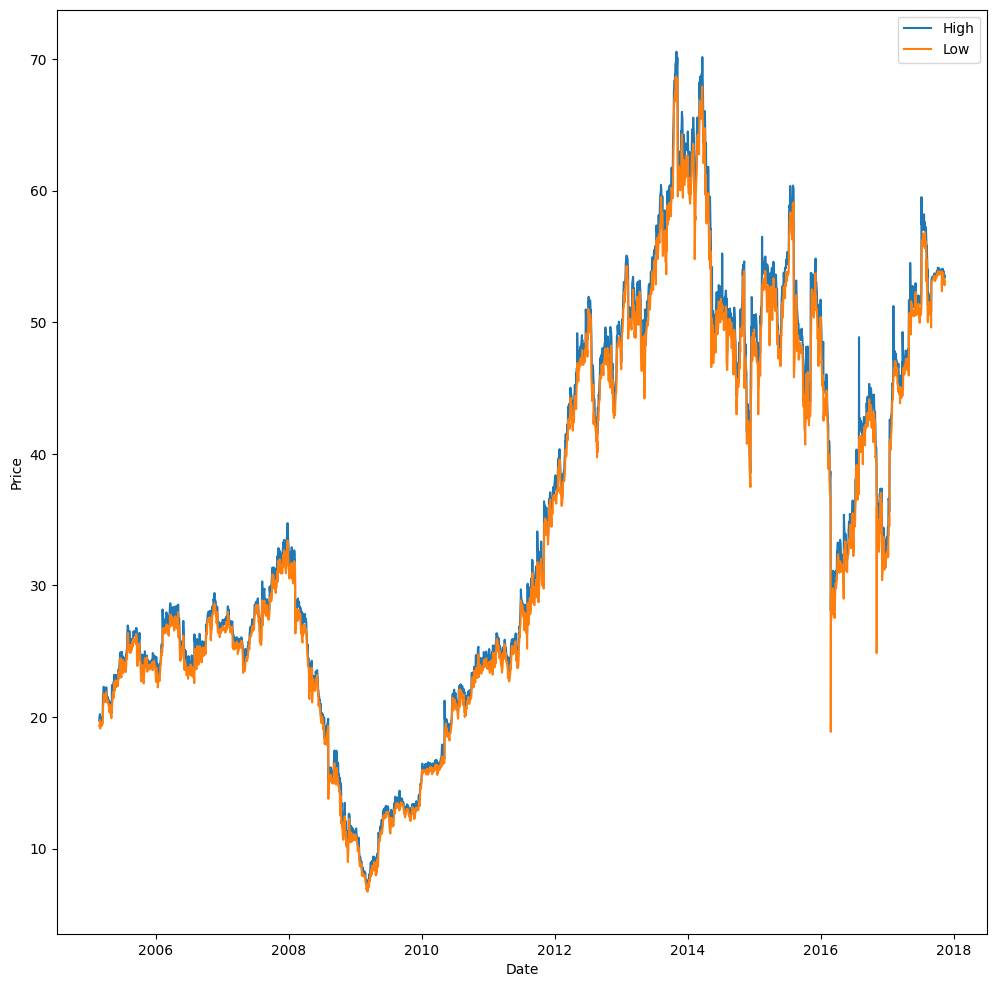

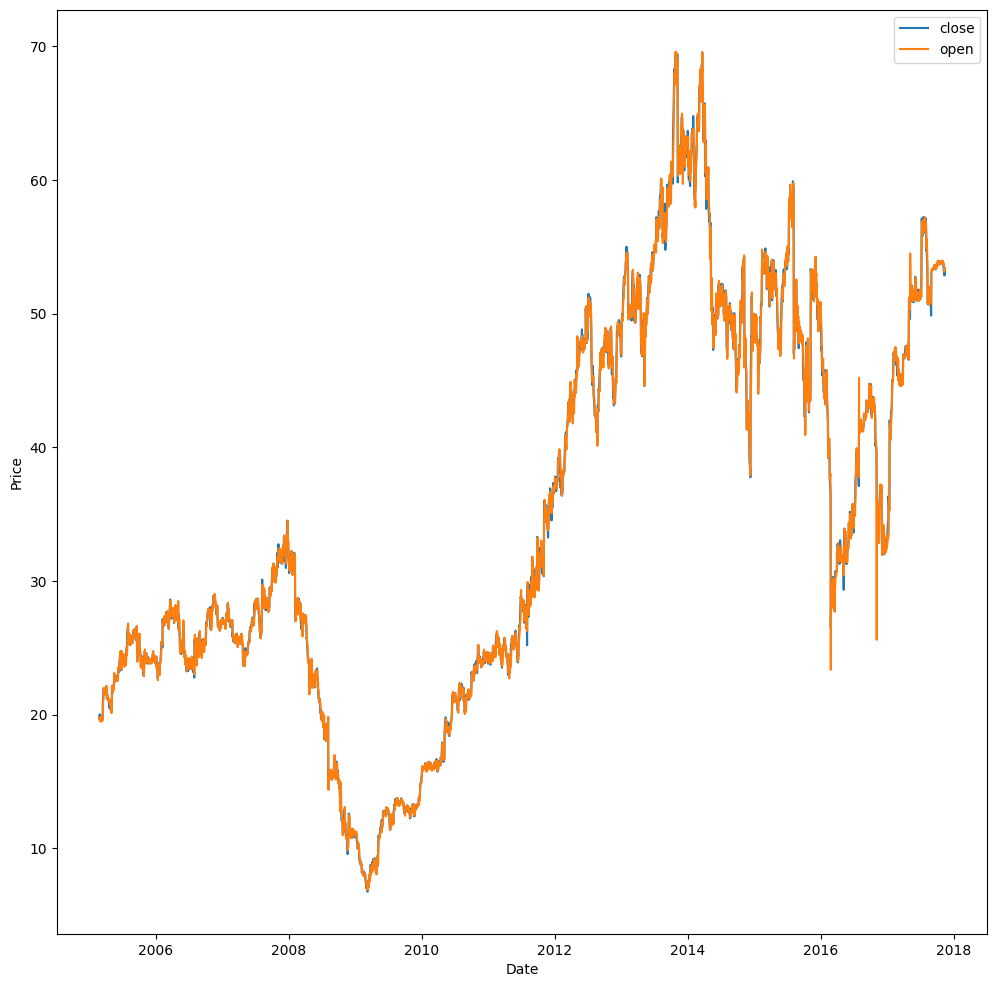

        Open    High     Low   Close   Volume
0     19.730  19.730  19.305  19.700   176690
1     19.815  20.140  19.385  20.015   280416
2     19.800  20.215  19.765  19.905   285522
3     19.500  19.625  19.400  19.560   938764
4     19.600  19.770  19.125  19.595   689216
...      ...     ...     ...     ...      ...
3196  53.700  53.700  53.050  53.150  1330652
3197  53.150  53.525  53.150  53.400  1081833
3198  53.400  53.550  53.100  53.450   998886
3199  53.200  53.350  52.800  52.850  1777744
3200  53.400  53.525  53.225  53.400  4990261

[3201 rows x 5 columns]


In [26]:
st3_1, st3_2 = Initial("abco.us.txt")

            Date     Open     High      Low    Close  Volume  OpenInt
0     2005-02-25   6.4987   6.6009   6.4668   6.5753   55766        0
1     2005-02-28   6.6072   6.7669   6.5944   6.6263   49343        0
2     2005-03-01   6.6391   6.6773   6.6072   6.6072   31643        0
3     2005-03-02   6.5753   6.6072   6.5434   6.5816   27101        0
4     2005-03-03   6.5753   6.6135   6.5562   6.5944   17387        0
...          ...      ...      ...      ...      ...     ...      ...
3185  2017-11-06  14.3998  14.4802  14.3900  14.4400   62423        0
3186  2017-11-07  14.4400  14.4400  14.4000  14.4000    6722        0
3187  2017-11-08  14.3400  14.4352  14.3400  14.3781    6304        0
3188  2017-11-09  14.3300  14.3737  14.2800  14.3200   18761        0
3189  2017-11-10  14.2500  14.3000  14.2400  14.3000   10658        0

[3190 rows x 7 columns]


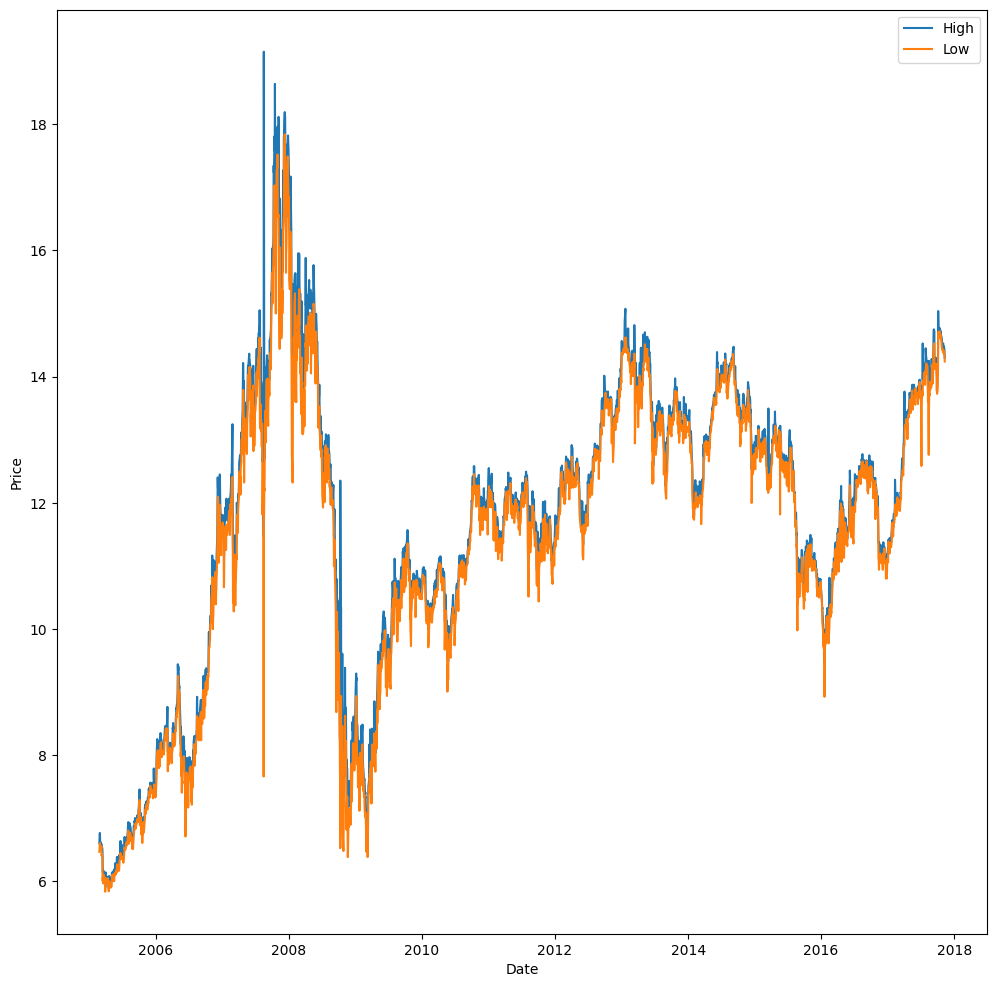

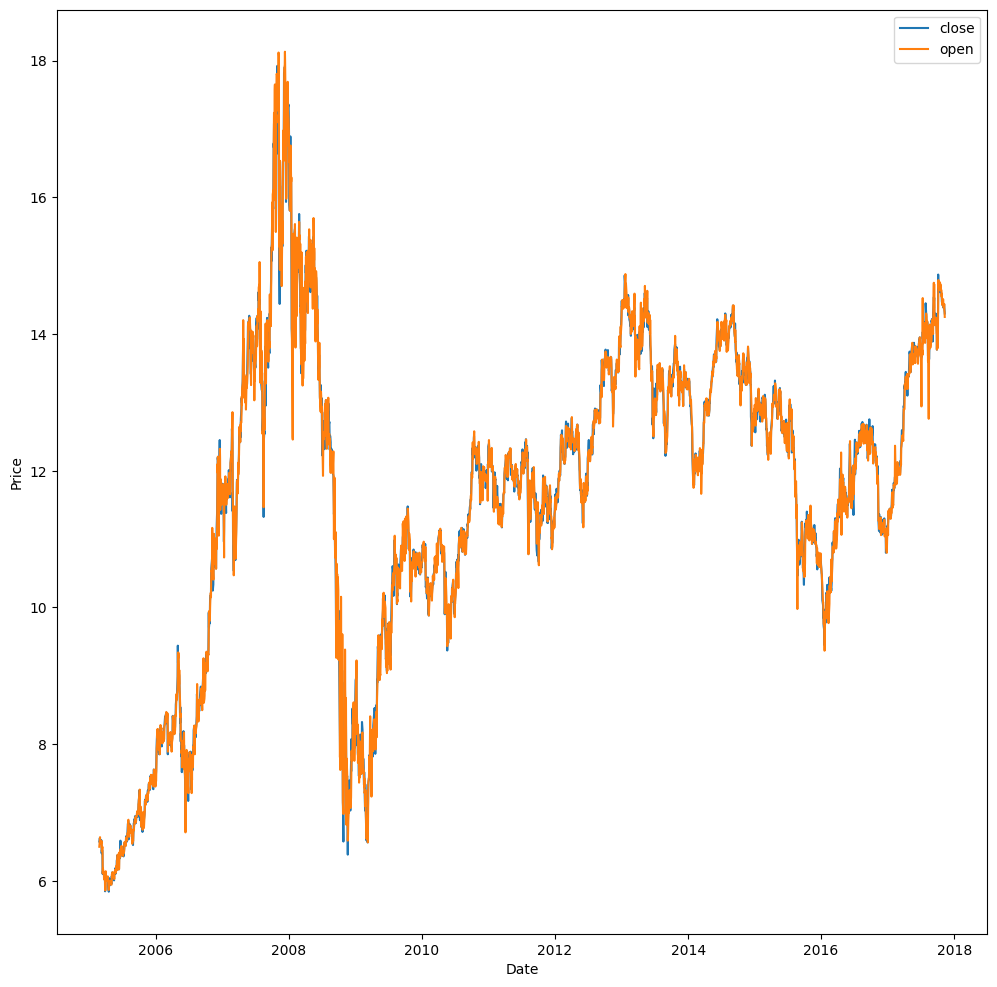

         Open     High      Low    Close  Volume
0      6.4987   6.6009   6.4668   6.5753   55766
1      6.6072   6.7669   6.5944   6.6263   49343
2      6.6391   6.6773   6.6072   6.6072   31643
3      6.5753   6.6072   6.5434   6.5816   27101
4      6.5753   6.6135   6.5562   6.5944   17387
...       ...      ...      ...      ...     ...
3185  14.3998  14.4802  14.3900  14.4400   62423
3186  14.4400  14.4400  14.4000  14.4000    6722
3187  14.3400  14.4352  14.3400  14.3781    6304
3188  14.3300  14.3737  14.2800  14.3200   18761
3189  14.2500  14.3000  14.2400  14.3000   10658

[3190 rows x 5 columns]


In [27]:
st4_1, st4_2 = Initial("abe.us.txt")

In [28]:
st = pd.concat((st1_1, st2_1, st3_1, st4_1), axis = 1)

In [29]:
st

,Open,High,Low,Close,Volume,OpenInt,Open,High,Low,Close,...,Low,Close,Volume,OpenInt,Open,High,Low,Close,Volume,OpenInt
Date,,,,,,,,,,,,,,,,,,,,,
2005-02-25,2.7985,2.8152,2.7679,2.7958,47033,0,16.686,17.412,16.587,17.365,...,19.305,19.700,176690,0,6.4987,6.6009,6.4668,6.5753,55766.0,0.0
2005-02-28,2.7595,2.8540,2.7486,2.8540,58791,0,17.074,17.211,16.705,16.937,...,19.385,20.015,280416,0,6.6072,6.7669,6.5944,6.6263,49343.0,0.0
2005-03-01,2.8540,2.8540,2.7541,2.8095,88448,0,17.220,17.402,17.162,17.402,...,19.765,19.905,285522,0,6.6391,6.6773,6.6072,6.6072,31643.0,0.0
2005-03-02,2.8124,2.8485,2.7595,2.8235,130879,0,16.985,17.665,16.985,17.422,...,19.400,19.560,938764,0,6.5753,6.6072,6.5434,6.5816,27101.0,0.0
2005-03-03,2.7875,2.8540,2.7541,2.8317,117092,0,17.560,17.579,17.355,17.550,...,19.125,19.595,689216,0,6.5753,6.6135,6.5562,6.5944,17387.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-11-06,34.5000,34.7500,34.2500,34.6500,107802,0,48.150,48.450,47.755,47.900,...,53.050,53.150,1330652,0,14.3998,14.4802,14.3900,14.4400,62423.0,0.0
2017-11-07,34.6500,34.7500,34.4000,34.6000,180383,0,47.800,48.050,46.650,46.650,...,53.150,53.400,1081833,0,14.4400,14.4400,14.4000,14.4000,6722.0,0.0
2017-11-08,34.5000,35.2500,34.1000,34.4250,102899,0,46.650,47.450,45.950,46.500,...,53.100,53.450,998886,0,14.3400,14.4352,14.3400,14.3781,6304.0,0.0


In [30]:
st.dropna(inplace = True)

In [31]:
st = st.drop("OpenInt", axis = 1)

In [32]:
st.columns = ['Open_1', 'High_1', 'Low_1', 'Close_1', 'Volume_1', 'Open_2', 'High_2', 'Low_2', 'Close_2', 'Volume_2', 'Open_3', 'High_3', 'Low_3', 'Close_3', 'Volume_3', 'Open_4', 'High_4', 'Low_4', 'Close_4', 'Volume_4']

In [33]:
st

,Open_1,High_1,Low_1,Close_1,Volume_1,Open_2,High_2,Low_2,Close_2,Volume_2,Open_3,High_3,Low_3,Close_3,Volume_3,Open_4,High_4,Low_4,Close_4,Volume_4
Date,,,,,,,,,,,,,,,,,,,,
2005-02-25,2.7985,2.8152,2.7679,2.7958,47033,16.686,17.412,16.587,17.365,54991,19.730,19.730,19.305,19.700,176690,6.4987,6.6009,6.4668,6.5753,55766.0
2005-02-28,2.7595,2.8540,2.7486,2.8540,58791,17.074,17.211,16.705,16.937,42870,19.815,20.140,19.385,20.015,280416,6.6072,6.7669,6.5944,6.6263,49343.0
2005-03-01,2.8540,2.8540,2.7541,2.8095,88448,17.220,17.402,17.162,17.402,16751,19.800,20.215,19.765,19.905,285522,6.6391,6.6773,6.6072,6.6072,31643.0
2005-03-02,2.8124,2.8485,2.7595,2.8235,130879,16.985,17.665,16.985,17.422,26016,19.500,19.625,19.400,19.560,938764,6.5753,6.6072,6.5434,6.5816,27101.0
2005-03-03,2.7875,2.8540,2.7541,2.8317,117092,17.560,17.579,17.355,17.550,15486,19.600,19.770,19.125,19.595,689216,6.5753,6.6135,6.5562,6.5944,17387.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-11-06,34.5000,34.7500,34.2500,34.6500,107802,48.150,48.450,47.755,47.900,69296,53.700,53.700,53.050,53.150,1330652,14.3998,14.4802,14.3900,14.4400,62423.0
2017-11-07,34.6500,34.7500,34.4000,34.6000,180383,47.800,48.050,46.650,46.650,160746,53.150,53.525,53.150,53.400,1081833,14.4400,14.4400,14.4000,14.4000,6722.0
2017-11-08,34.5000,35.2500,34.1000,34.4250,102899,46.650,47.450,45.950,46.500,147688,53.400,53.550,53.100,53.450,998886,14.3400,14.4352,14.3400,14.3781,6304.0


### How one time series affect other 
To predict the closing price of a specific stock, we combine historical data from multiple stocks into a single dataset. Each stock's open, close, high, and low prices over time become features for the prediction model. By analyzing these features alongside the target stock's data, we aim to understand how movements in other stocks influence the target stock's price. Machine learning techniques are then applied to identify patterns and correlations, providing insights into interrelationships among stocks within the market context.

<Axes: >

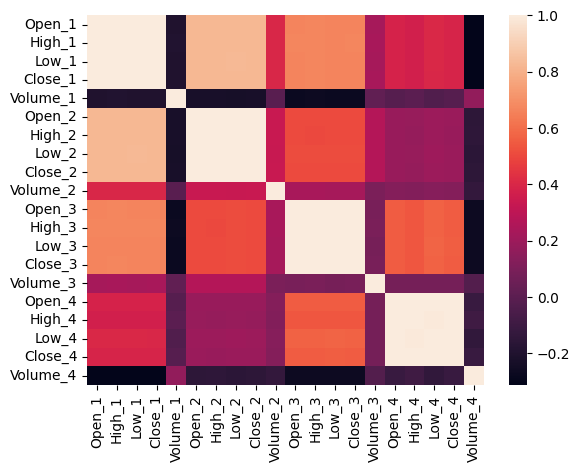

In [34]:
sns.heatmap(st.corr())

In [35]:
features = ['Open_1', 'High_1', 'Low_1', 'Close_1', 'Open_2', 'High_2', 'Low_2', 'Close_2', 'Open_3', 'High_3', 'Low_3', 'Close_3', 'Open_4', 'High_4', 'Low_4', 'Close_4']
data = st[features].values

In [36]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split

In [37]:
def prepare_sequences(data, n_steps):
    X, y = [], []
    for i in range(len(data)):
        end_ix = i + n_steps
        if end_ix >= len(data):
            break
        seq_x, seq_y = data[i:end_ix, :], data[end_ix, 3]  # Use 'Close_1' as target
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

### Preparing data for training 
For forecasting we use history of 14 days to predict 15 th day <br>
For that we form batches, with each batch conating 14 day history and 16 feature

In [38]:
split = int(0.8 * len(data))
X_train_unscaled, X_test_unscaled = data[:split], data[split:]

In [39]:
scaler = MinMaxScaler()
scaler.fit(X_train_unscaled)
#X_train1= scaler.transform(X_train_unscaled)
X_train1= X_train_unscaled
#X_test1 = scaler.transform(X_test_unscaled)
X_test1 = X_test_unscaled

In [40]:
n_steps = 14
X_train, y_train = prepare_sequences(X_train1, n_steps)
X_test, y_test = prepare_sequences(X_test1, n_steps)

In [41]:
X_train.shape

(2538, 14, 16)

In [42]:
y_train.shape

(2538,)

In [43]:
X_train = torch.tensor(X_train, dtype=torch.float32)
y_train = torch.tensor(y_train, dtype=torch.float32)
X_test = torch.tensor(X_test, dtype=torch.float32)
y_test = torch.tensor(y_test, dtype=torch.float32)

In [54]:
class LSTMForecast(nn.Module):
    def __init__(self):
        super(LSTMForecast, self).__init__()
        self.lstm = nn.LSTM(16, 64)
        self.fc1 = nn.Linear(64, 32)
        self.ac = nn.ReLU()
        self.fc2 = nn.Linear(32, 1)

    def forward(self, x):
        out, _ = self.lstm(x.view(14, 1, 16))
        #print(out.shape)
        out = self.fc1(out.view(14, -1)[-1])  # Use output from the last time step
        out = self.ac(out)
        out = self.fc2(out)
        return out

## Model used for training 
LSTM is used followed by fully connected layer, <br>
LSTM produces output of 64 size by taking in input of size 16 these 64 features produced are passed into fully connected Neural Network.

In [55]:
model = LSTMForecast()
print(model)

LSTMForecast(
  (lstm): LSTM(16, 64)
  (fc1): Linear(in_features=64, out_features=32, bias=True)
  (ac): ReLU()
  (fc2): Linear(in_features=32, out_features=1, bias=True)
)


In [56]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

num_epochs = 100
batch_size = 1
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)
model.train()
for epoch in range(num_epochs):
    for i in range(0, len(X_train), batch_size):
        inputs = X_train[i, :, :]
        targets = y_train[i]
        inputs = inputs.to(device)
        targets = targets.to(device)
        
        # Forward pass
        outputs = model(inputs)
        # Compute loss
        loss = criterion(outputs, targets)

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        #torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)  # Adjust max_norm as needed
        optimizer.step()
        #print(i, loss)
    if (epoch+1) % 1 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

Epoch [1/100], Loss: 2.2329
Epoch [2/100], Loss: 3.1005
Epoch [3/100], Loss: 1.3695
Epoch [4/100], Loss: 1.2589
Epoch [5/100], Loss: 0.8318
Epoch [6/100], Loss: 0.7406
Epoch [7/100], Loss: 0.9295
Epoch [8/100], Loss: 0.9772
Epoch [9/100], Loss: 0.5648
Epoch [10/100], Loss: 0.5513
Epoch [11/100], Loss: 0.4789
Epoch [12/100], Loss: 0.3634
Epoch [13/100], Loss: 0.3849
Epoch [14/100], Loss: 0.1866
Epoch [15/100], Loss: 0.0481
Epoch [16/100], Loss: 0.0946
Epoch [17/100], Loss: 0.1208
Epoch [18/100], Loss: 0.1708
Epoch [19/100], Loss: 0.1703
Epoch [20/100], Loss: 0.2151
Epoch [21/100], Loss: 0.1798
Epoch [22/100], Loss: 0.1540
Epoch [23/100], Loss: 0.1113
Epoch [24/100], Loss: 0.3327
Epoch [25/100], Loss: 0.2231
Epoch [26/100], Loss: 0.1495
Epoch [27/100], Loss: 0.1587
Epoch [28/100], Loss: 0.1687
Epoch [29/100], Loss: 0.1880
Epoch [30/100], Loss: 0.1980
Epoch [31/100], Loss: 0.1309
Epoch [32/100], Loss: 0.2057
Epoch [33/100], Loss: 0.2199
Epoch [34/100], Loss: 0.2080
Epoch [35/100], Loss: 0

In [57]:
model.eval()
y_pred = []

with torch.no_grad():
    for i in range(len(X_train)):
        X_train = X_train.to(device)
        
        input_seq = X_train[i, :, :] 
        output = model(input_seq)  
        
        #predicted_value = scaler.inverse_transform(np.repeat(output.cpu().numpy(), 16).reshape(1, -1))
        #y_pred.append(predicted_value[0, -1])  # Extract the predicted Close_1 value
        y_pred.append(output.cpu().numpy())

y_pred_actual_1 = np.array(y_pred)
#y_train_actual = scaler.inverse_transform(np.repeat(np.array(y_train.cpu().numpy().reshape(-1, 1)), 16, axis = 1))[:, 1]
y_train_actual = y_train.cpu().numpy()

In [58]:
y_pred_actual_1

array([[ 3.3456523],
       [ 3.3176017],
       [ 3.233914 ],
       ...,
       [23.652046 ],
       [23.392157 ],
       [23.64038  ]], dtype=float32)

In [59]:
model.eval()
y_pred = []

with torch.no_grad():
    for i in range(len(X_test)):
        X_test = X_test.to(device)
        
        input_seq = X_test[i, :, :] 
        output = model(input_seq)  
        
        #predicted_value = scaler.inverse_transform(np.repeat(output.cpu().numpy(), 16).reshape(1, -1))
        #y_pred.append(predicted_value[0, -1])  # Extract the predicted Close_1 value
        y_pred.append(output.cpu().numpy())

y_pred_actual = np.array(y_pred)
#y_test_actual = scaler.inverse_transform(np.repeat(np.array(y_test.cpu().numpy().reshape(-1, 1)), 16, axis = 1))[:, 1]
y_test_actual = y_test.cpu().numpy()

In [60]:
F.mse_loss(torch.tensor(y_pred_actual.squeeze()), torch.tensor(y_test_actual))

tensor(44.9843)

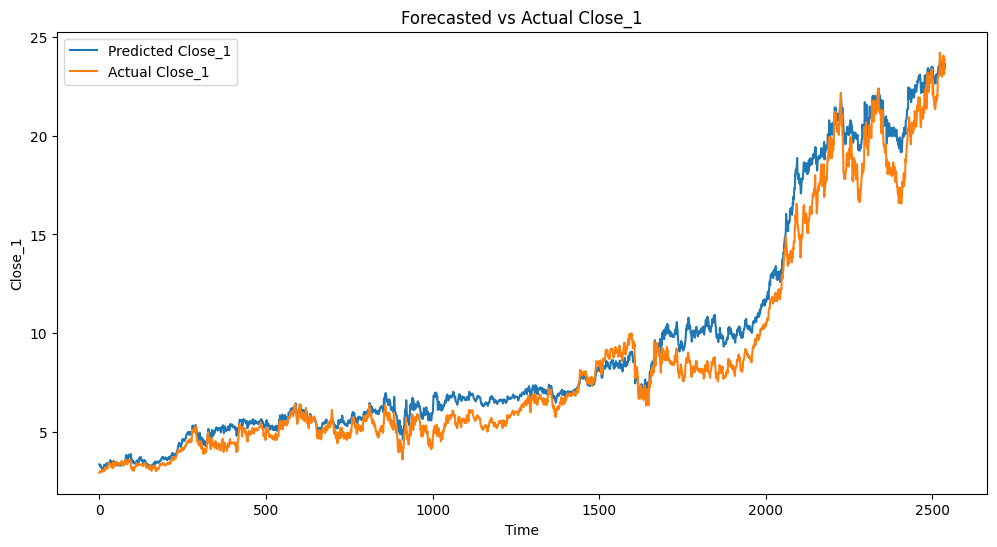

In [61]:
plt.figure(figsize=(12, 6))
plt.plot(y_pred_actual_1, label='Predicted Close_1')
plt.plot(y_train_actual, label='Actual Close_1')
plt.title('Forecasted vs Actual Close_1')
plt.xlabel('Time')
plt.ylabel('Close_1')
plt.legend()
plt.show()

Blue line shows predicted value on giving training data <br>
Orange line shows Actual Training value

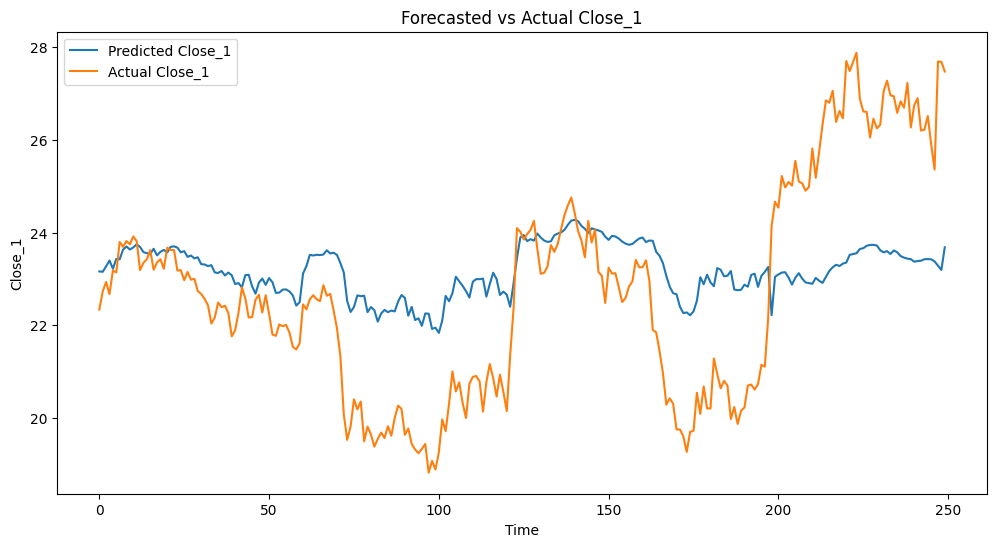

In [64]:
plt.figure(figsize=(12, 6))
plt.plot(y_pred_actual[:250], label='Predicted Close_1')
plt.plot(y_test_actual[:250], label='Actual Close_1')
plt.title('Forecasted vs Actual Close_1')
plt.xlabel('Time')
plt.ylabel('Close_1')
plt.legend()
plt.show()

Orange shows actual test data close price <br>
Blue shows predicted value, as we can see that predicted value might be bit off but the trend of stock is captured

# Q2

In [1]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from torch.utils.data import DataLoader, Dataset
import torchvision
from torch.autograd import grad
from torchvision import transforms
import torch.nn as nn
#from torchsummary import summary
import torch.nn.functional as F
import cv2
import seaborn as sns
import json
from PIL import Image
import torch.optim as optim

In [2]:
!git clone https://huggingface.co/datasets/neuralcatcher/hateful_memes

Cloning into 'hateful_memes'...
remote: Enumerating objects: 9700, done.
remote: Counting objects: 100% (9700/9700), done.
remote: Compressing objects: 100% (9682/9682), done.
remote: Total 9700 (delta 17), reused 9700 (delta 17), pack-reused 0
Receiving objects: 100% (9700/9700), 1.85 MiB | 17.56 MiB/s, done.
Resolving deltas: 100% (17/17), done.
Updating files: 100% (9672/9672), done.
Filtering content: 100% (9664/9664), 3.13 GiB | 20.19 MiB/s, done.


In [3]:
jasonFile = '/kaggle/working/hateful_memes/train.jsonl'
with open(jasonFile, 'r') as f:
    dataset = [json.loads(i) for i in f]

In [4]:
dataset

[{'id': '42953',
  'img': 'img/42953.png',
  'label': 0,
  'text': 'its their character not their color that matters'},
 {'id': '23058',
  'img': 'img/23058.png',
  'label': 0,
  'text': "don't be afraid to love again everyone is not like your ex"},
 {'id': '13894',
  'img': 'img/13894.png',
  'label': 0,
  'text': 'putting bows on your pet'},
 {'id': '37408',
  'img': 'img/37408.png',
  'label': 0,
  'text': 'i love everything and everybody! except for squirrels i hate squirrels'},
 {'id': '82403',
  'img': 'img/82403.png',
  'label': 0,
  'text': 'everybody loves chocolate chip cookies, even hitler'},
 {'id': '16952',
  'img': 'img/16952.png',
  'label': 0,
  'text': 'go sports! do the thing! win the points!'},
 {'id': '76932',
  'img': 'img/76932.png',
  'label': 0,
  'text': "fine you're right. now can we fucking drop it?"},
 {'id': '70914',
  'img': 'img/70914.png',
  'label': 1,
  'text': 'tattoos are bad for your health i know 5 million people that had tattoos and they all died'

Loading the data into structed format so that it can be given to dataset class, later which can be used in train loader

In [5]:
image = []
text = []
label = []
for i in dataset:
    try:
        img = Image.open(f'/kaggle/working/hateful_memes/{i["img"]}').convert("RGB")
        image.append(img)
        label.append(i['label'])
        text.append(i['text'])
    except FileNotFoundError:
        print(f'Image Not Found {i["img"]}')

Image Not Found img/23058.png
Image Not Found img/37408.png
Image Not Found img/25489.png
Image Not Found img/97628.png
Image Not Found img/14238.png
Image Not Found img/64318.png
Image Not Found img/25719.png
Image Not Found img/72598.png
Image Not Found img/43078.png
Image Not Found img/01569.png
Image Not Found img/06418.png
Image Not Found img/48279.png
Image Not Found img/20619.png
Image Not Found img/81059.png
Image Not Found img/12548.png
Image Not Found img/40259.png
Image Not Found img/53289.png
Image Not Found img/34508.png
Image Not Found img/25468.png
Image Not Found img/96258.png
Image Not Found img/96578.png
Image Not Found img/35618.png
Image Not Found img/05249.png
Image Not Found img/57349.png
Image Not Found img/78409.png
Image Not Found img/20568.png
Image Not Found img/84269.png
Image Not Found img/68079.png
Image Not Found img/12348.png
Image Not Found img/21948.png
Image Not Found img/26759.png
Image Not Found img/27398.png
Image Not Found img/23748.png
Image Not 

In [6]:
jasonFileTest = '/kaggle/working/hateful_memes/test_seen.jsonl'
with open(jasonFileTest, 'r') as f:
    datasetTest = [json.loads(i) for i in f]

In [7]:
imageTest = []
textTest = []
labelTest = []
for i in datasetTest:
    try:
        img = Image.open(f'/kaggle/working/hateful_memes/{i["img"]}').convert("RGB")
        imageTest.append(img)
        labelTest.append(i['label'])
        textTest.append(i['text'])
    except FileNotFoundError:
        print(f'Image Not Found {i["img"]}')

Image Not Found img/05429.png
Image Not Found img/43728.png
Image Not Found img/47829.png
Image Not Found img/35279.png
Image Not Found img/86139.png
Image Not Found img/17209.png
Image Not Found img/82749.png
Image Not Found img/56908.png
Image Not Found img/04958.png
Image Not Found img/18239.png
Image Not Found img/64279.png
Image Not Found img/02789.png
Image Not Found img/87039.png
Image Not Found img/48059.png
Image Not Found img/72019.png
Image Not Found img/10548.png
Image Not Found img/09638.png
Image Not Found img/67149.png
Image Not Found img/23419.png
Image Not Found img/74029.png
Image Not Found img/05219.png
Image Not Found img/35198.png
Image Not Found img/58079.png
Image Not Found img/07689.png
Image Not Found img/45269.png
Image Not Found img/90538.png
Image Not Found img/04879.png
Image Not Found img/24689.png
Image Not Found img/31468.png
Image Not Found img/63719.png
Image Not Found img/15379.png
Image Not Found img/28579.png
Image Not Found img/23619.png
Image Not 

Visualizing data

In [8]:
labelTest[90]

0

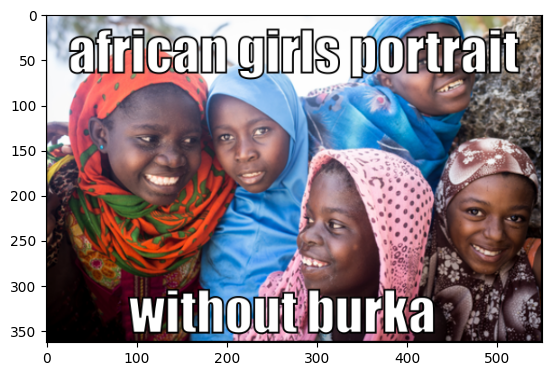

In [9]:
plt.imshow(imageTest[90])

In [10]:
labelTest[19]

1

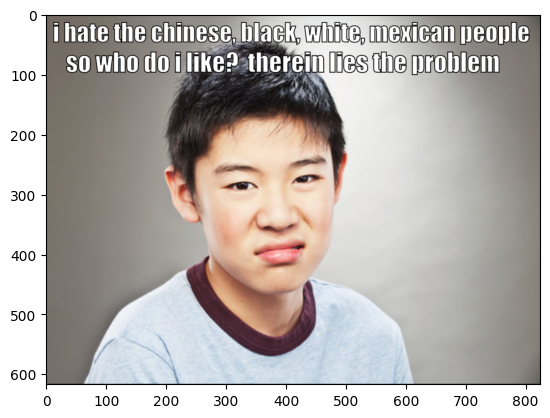

In [11]:
plt.imshow(imageTest[19])

In [8]:
import re
def clean_text(text):
    text = re.sub(r'#\w+', '', text)
    text = re.sub(r'@\w+', '', text)
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    text = re.sub(r'\s+', ' ', text)

    return text.strip()

In [9]:
for i, j in enumerate(textTest):
    textTest[i] = clean_text(j)

In [10]:
for i, j in enumerate(text):
    text[i] = clean_text(j)

In [10]:
total_text = text + textTest

In [11]:
max_text_length = max(len(tt) for tt in total_text)

In [12]:
max_text_length

427

For **Model 1**(described later) we pre process text <br>
First we tokenize <br>
Second we form vocab <br>
Then we convert sentence words to indices <br>
We pad them so that every sentence is of equal length

In [13]:
import nltk
from nltk.tokenize import word_tokenize

nltk.download('punkt')

[nltk_data] Downloading package punkt to /usr/share/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [14]:
def tokenize_text(text):
    # Tokenize text into words
    tokens = word_tokenize(text)
    return tokens

In [15]:
tokenized_text = []
for i in total_text:
    tokenized_text.append(tokenize_text(i))

In [16]:
def build_vocab(tokenized_texts):
    vocab = {}
    index = 0
    for tokens in tokenized_texts:
        for token in tokens:
            if token not in vocab:
                vocab[token] = index
                index += 1
    return vocab

In [17]:
vocab = build_vocab(tokenized_text)

In [18]:
def text_to_indices(tokenized_text, vocab):
    return [vocab[token] if token in vocab else vocab['<unk>'] for token in tokenized_text]

In [19]:
def preprocess_text(text):
    tokenized_text = tokenize_text(text)
    indexed_text = text_to_indices(tokenized_text, vocab)
    return torch.tensor(indexed_text, dtype=torch.long)

In [22]:
class HateMemeDataSet(Dataset):
    def __init__(self, image, text, label,image_transform = None, prepare_seq = True):
        self.image = image
        self.text = text
        self.label = label
        self.image_transform = image_transform
        self.prepare_seq = prepare_seq

    def __len__(self):
        return len(self.image)

    def __getitem__(self, idx):
        img = self.image[idx]
        txt = self.text[idx]
        label = self.label[idx]
        if self.image_transform:
            img = self.image_transform(img)
        if self.prepare_seq:
            txt = preprocess_text(txt)
        padded_texts = torch.nn.functional.pad(txt, pad=(0, max_text_length - len(txt)))
            
        return (img, padded_texts, label)

In [23]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [24]:
train_dataset = HateMemeDataSet(image, text, label, image_transform=transform)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

In [25]:
test_dataset = HateMemeDataSet(imageTest, textTest, labelTest, image_transform=transform)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=True)

In [11]:
import torchvision.models as models  

### Model 1
We take image embedding from resnet50 after extending it with fully connected layer which output 256 features <br>
For text embedding we fist pass it through embedding layer and then train LSTM layer and take final hidden state as feature vector for text <br>
Then we concatenate text and image feature vector and then classify using Fully connected Neural Network

In [41]:
class ImageTextClassifier(nn.Module):
    def __init__(self, num_classes):
        super(ImageTextClassifier, self).__init__()
        
       
        self.resnet = models.resnet50(pretrained=True)
        self.resnet.fc = nn.Linear(self.resnet.fc.in_features, 256)  # Change output features of ResNet
        
       
        self.embedding = nn.Embedding(num_embeddings=10000, embedding_dim=128)
        self.lstm = nn.LSTM(input_size=128, hidden_size=256, num_layers=1, batch_first=True)
        
        self.fc1 = nn.Linear(256 + 256, 128)
        self.fc2 = nn.Linear(128, num_classes)
        self.dropout = nn.Dropout(0.5)

    def forward(self, images, texts):
        
        image_features = self.resnetc(images)
        image_features = self.dropout(image_features)
        
      
        text_embeddings = self.embedding(texts)
        _, (text_features, _) = self.lstm(text_embeddings)
        text_features = self.dropout(text_features[-1]) 
        
        # Concatenate image and text features
        combined_features = torch.cat((image_features, text_features), dim=1)
        
        x = self.fc1(combined_features)
        x = self.dropout(x)
        x = self.fc2(x)
        return x

In [12]:
from torch.optim.lr_scheduler import LambdaLR

In [41]:
def calculate_accuracy(outputs, labels):
    _, predicted = torch.max(outputs, 1)
    correct = (predicted == labels).sum().item()
    total = labels.size(0)
    accuracy = (correct / total)*100
    return accuracy

def train(model, train_loader, criterion, optimizer, num_epochs, device, scheduler):
    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0.0
        epoch_accuracy = 0.0
        
        for images, texts, labels in train_loader:
            # Move data to GPU
            images = images.to(device)
            texts = texts.to(device)
            labels = labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(images, texts)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            epoch_loss += loss.item()
            epoch_accuracy += calculate_accuracy(outputs, labels)
            ##print(epoch_loss)
        # average loss and accuracy for the epoch
        epoch_loss /= len(train_loader)
        epoch_accuracy /= len(train_loader)
        
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.4f}')
        model.eval()
        correct_predictions = 0
        total_samples = 0
        with torch.no_grad():
            for images, texts, labels in test_loader:
                images = images.to(device)
                texts = texts.to(device)
                labels = labels.to(device)
        
                test_outputs = model(images, texts)
        
                _, predicted = torch.max(test_outputs, 1)
        
                correct_predictions += (predicted == labels).sum().item()
                total_samples += labels.size(0)  # Increment total number of samples

        test_accuracy = (correct_predictions / total_samples) * 100
        print(f'Test Accuracy: {test_accuracy:.4f}')
        scheduler.step()
    torch.save({'epoch': epoch,'model_state_dict': model.state_dict(),'optimizer_state_dict': optimizer.state_dict()}, 'model.pth')
    model.train()
    
    
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = ImageTextClassifier(num_classes=2)
model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

lr_lambda = lambda epoch: 0.01 * (0.1 ** (epoch // 2))

scheduler = LambdaLR(optimizer, lr_lambda=lr_lambda)

num_epochs = 5

train(model, train_loader, criterion, optimizer, num_epochs, device, scheduler)

Epoch [1/5], Loss: 0.6596, Accuracy: 63.4133
Test Accuracy: 52.6380
Epoch [2/5], Loss: 0.6105, Accuracy: 67.4467
Test Accuracy: 51.6564
Epoch [3/5], Loss: 0.4684, Accuracy: 77.2265
Test Accuracy: 53.7423
Epoch [4/5], Loss: 0.3085, Accuracy: 86.9421
Test Accuracy: 53.4969
Epoch [5/5], Loss: 0.1874, Accuracy: 93.7056
Test Accuracy: 53.1288


In [13]:
from transformers import BertModel, BertTokenizer

tokenizerBert = BertTokenizer.from_pretrained('bert-base-uncased')
bert = BertModel.from_pretrained('bert-base-uncased',)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

### Model 2
In this instead of LSTM we use pre-trained BERT transformer and its tokenizer for obtaing text embedding, rest procedure remains the same 

In [14]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
from transformers import BertModel, BertTokenizer

class ImageTextClassifierTransformer(nn.Module):
    def __init__(self, num_classes, tokenizerBert, Bert):
        super(ImageTextClassifierTransformer, self).__init__()
        
        self.resnet = models.resnet50(pretrained=True)
        self.resnet.fc = nn.Linear(self.resnet.fc.in_features, 256)  # Change output features of ResNet
        
        
        self.tokenizer = tokenizerBert
        
        # Text branch (BERT-based text embedding)
        self.bert_model = Bert
        self.text_embedding_dim = self.bert_model.config.hidden_size
        
        self.fc1 = nn.Linear(256 + self.text_embedding_dim, 128)
        self.fc2 = nn.Linear(128, num_classes)
        self.dropout = nn.Dropout(0.5)

    def forward(self, images, text, device):
        image_features = self.resnet(images)
        image_features = self.dropout(image_features)
        image_features.clone().detach().float().requires_grad_(True)
        
        input_ids = self.tokenizer(text, padding=True, truncation=True, return_tensors='pt')['input_ids']
        input_ids.clone().detach().float().requires_grad_(True)
        input_ids = input_ids.to(device)
        
        bert_outputs = self.bert_model(input_ids).pooler_output
        text_features = bert_outputs
        
        text_features = self.dropout(text_features)
        
        # Concatenate image and text features
        combined_features = torch.cat((image_features, text_features), dim=1)
        
        # Classification
        x = F.relu(self.fc1(combined_features))
        x = self.dropout(x)
        x = self.fc2(x)
        return x

In [15]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

In [16]:
class HateMemeDataSet(Dataset):
    def __init__(self, image, text, label,image_transform = None, prepare_seq = False):
        self.image = image
        self.text = text
        self.label = label
        self.image_transform = image_transform
        self.prepare_seq = prepare_seq

    def __len__(self):
        return len(self.image)

    def __getitem__(self, idx):
        img = self.image[idx]
        txt = self.text[idx]
        label = self.label[idx]
        if self.image_transform:
            img = self.image_transform(img)
        if self.prepare_seq:
            input_ids = tokenizer(text, padding=True, truncation=True, return_tensors='pt')['input_ids']
            
        return (img, txt, label)

In [17]:
train_dataset = HateMemeDataSet(image, text, label, image_transform=transform)
train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True)

In [18]:
test_dataset = HateMemeDataSet(imageTest, textTest, labelTest, image_transform=transform)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=True)

In [19]:
def calculate_accuracy(outputs, labels):
    _, predicted = torch.max(outputs, 1)
    correct = (predicted == labels).sum().item()
    total = labels.size(0)
    accuracy = (correct / total)*100
    return accuracy

def train(model, train_loader, criterion, optimizer, num_epochs, device, scheduler):
    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0.0
        epoch_accuracy = 0.0
        for images, text, labels in train_loader:
            # Move data to GPU
            images = images.to(device)
            labels = labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(images, text, device)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            
            # Accumulate loss and calculate accuracy
            epoch_loss += loss.item()
            epoch_accuracy += calculate_accuracy(outputs, labels)

        epoch_loss /= len(train_loader)
        epoch_accuracy /= len(train_loader)
        
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}, Accuracy: {epoch_accuracy:.4f}')
        model.eval()
        correct_predictions = 0
        total_samples = 0
        with torch.no_grad():
            for images, texts, labels in test_loader:
                images = images.to(device)
                labels = labels.to(device)
        
                test_outputs = model(images, texts, device)
        
                _, predicted = torch.max(test_outputs, 1)
        
                correct_predictions += (predicted == labels).sum().item()
                total_samples += labels.size(0)  # Increment total number of samples

        test_accuracy = (correct_predictions / total_samples) * 100
        print(f'Test Accuracy: {test_accuracy:.4f}')
        scheduler.step()
    torch.save({'epoch': epoch,'model_state_dict': model.state_dict(),'optimizer_state_dict': optimizer.state_dict()}, 'model.pth')
    model.train()
    
    
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = ImageTextClassifierTransformer(num_classes=2, tokenizerBert = tokenizerBert, Bert = bert)
model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

lr_lambda = lambda epoch: 0.001 

scheduler = LambdaLR(optimizer, lr_lambda=lr_lambda)

num_epochs = 25

train(model, train_loader, criterion, optimizer, num_epochs, device, scheduler)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 104MB/s] 
We strongly recommend passing in an `attention_mask` since your input_ids may be padded. See https://huggingface.co/docs/transformers/troubleshooting#incorrect-output-when-padding-tokens-aren

Epoch [1/25], Loss: 0.6726, Accuracy: 58.6447
Test Accuracy: 51.6564
Epoch [2/25], Loss: 0.6520, Accuracy: 63.6862
Test Accuracy: 51.9018
Epoch [3/25], Loss: 0.6425, Accuracy: 64.6352
Test Accuracy: 51.7791
Epoch [4/25], Loss: 0.6196, Accuracy: 67.0225
Test Accuracy: 55.8282
Epoch [5/25], Loss: 0.5813, Accuracy: 71.5896
Test Accuracy: 58.6503
Epoch [6/25], Loss: 0.5555, Accuracy: 74.1400
Test Accuracy: 58.5276
Epoch [7/25], Loss: 0.5260, Accuracy: 75.6821
Test Accuracy: 60.2454
Epoch [8/25], Loss: 0.5082, Accuracy: 76.8980
Test Accuracy: 58.4049
Epoch [9/25], Loss: 0.4843, Accuracy: 78.4994
Test Accuracy: 58.2822
Epoch [10/25], Loss: 0.4675, Accuracy: 79.3891
Test Accuracy: 58.1595
Epoch [11/25], Loss: 0.4439, Accuracy: 80.2046
Test Accuracy: 58.7730
Epoch [12/25], Loss: 0.4184, Accuracy: 82.0878
Test Accuracy: 59.3865
Epoch [13/25], Loss: 0.3973, Accuracy: 83.4075
Test Accuracy: 59.2638
Epoch [14/25], Loss: 0.3676, Accuracy: 84.8458
Test Accuracy: 59.3865
Epoch [15/25], Loss: 0.3379, 

# Q3

In [2]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from torch.utils.data import DataLoader, Dataset
import torchvision
from torch.autograd import grad
from torchvision import transforms
import torch.nn as nn
#from torchsummary import summary
import torch.nn.functional as F
import cv2
import seaborn as sns

In [3]:
import os

In [4]:
harshPath = "/kaggle/input/imagesforq3/Q3/HarshGupta"
karanPath = "/kaggle/input/imagesforq3/Q3/Karan"
SanketPath = "/kaggle/input/imagesforq3/Q3/Sanket"
VedantPath = "/kaggle/input/imagesforq3/Q3/VedantUdan"

In [5]:
print("Number of images of Harsh = ",len(os.listdir(harshPath)))
print("Number of images of Vedant = ",len(os.listdir(VedantPath)))
print("Number of images of Sanket = ",len(os.listdir(SanketPath)))
print("Number of images of karan = ",len(os.listdir(karanPath)))

Number of images of Harsh =  50
Number of images of Vedant =  50
Number of images of Sanket =  50
Number of images of karan =  50


### Visualizing the Data

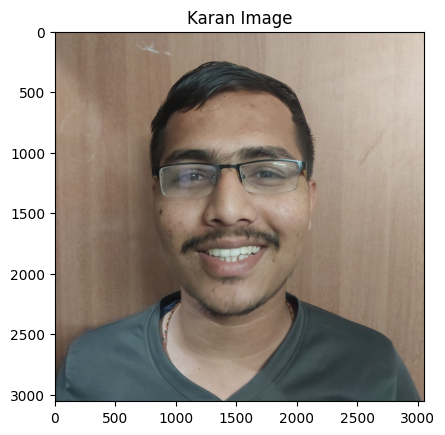

In [20]:
imgK = cv2.imread("/kaggle/input/imagesforq3/Q3/Karan/20240413_230442_002.jpg")
plt.title("Karan Image")
plt.imshow(cv2.cvtColor(imgK, cv2.COLOR_BGR2RGB))
plt.show()

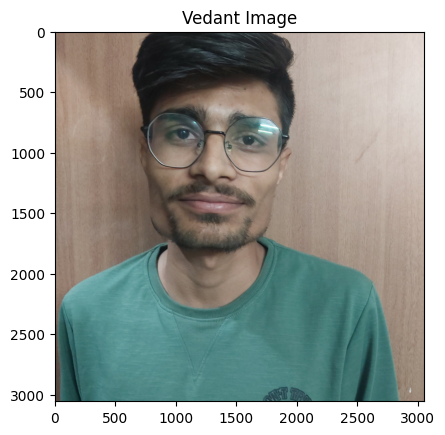

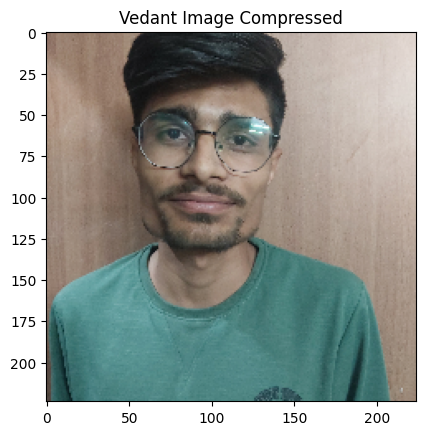

In [21]:
imgK = cv2.imread("/kaggle/input/imagesforq3/Q3/VedantTest/20240413_230340_004.jpg")
plt.title("Vedant Image")
plt.imshow(cv2.cvtColor(imgK, cv2.COLOR_BGR2RGB))
plt.show()

resized = cv2.resize(imgK,(224,224))
plt.title("Vedant Image Compressed")
plt.imshow(cv2.cvtColor(resized, cv2.COLOR_BGR2RGB))
plt.show()

### Forming csv files
These CSV file maps image name with label <br>
Helps forming custom data set

In [6]:
import os
import csv

folders = [
    (0, harshPath),
    (1, VedantPath),
    (2, SanketPath),
    (3, karanPath)
]

csv_file = '/kaggle/working/train_data.csv'

with open(csv_file, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['img_name', 'person_name'])  # Write header row

    for person_name, folder_path in folders:
        for filename in os.listdir(folder_path):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif')):
                writer.writerow([filename, person_name])


In [7]:
harshPathTest = "/kaggle/input/imagesforq3/Q3/HarshTest"
VedantPathTest = "/kaggle/input/imagesforq3/Q3/VedantTest"
SanketPathTest = "/kaggle/input/imagesforq3/Q3/SanketTest"
karanPathTest = "/kaggle/input/imagesforq3/Q3/KaranTest"

In [8]:
import os
import csv

folders = [
    (0, harshPathTest),
    (1, VedantPathTest),
    (2, SanketPathTest),
    (3, karanPathTest)
]

csv_file = '/kaggle/working/test_data.csv'

with open(csv_file, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['img_name', 'person_name'])  

    for person_name, folder_path in folders:
        for filename in os.listdir(folder_path):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif')):
                writer.writerow([filename, person_name])

### Data Preprocessing
Re-size the image to 224 x 224 <br>
Normalize them 

In [9]:
class CustomImageDataset(Dataset):
    def __init__(self, annotations_file, img_dir, transform=None, target_transform=None):
        self.img_labels = pd.read_csv(annotations_file)
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[idx, 0])
        image = cv2.imread(img_path)
        label = self.img_labels.iloc[idx, 1]
        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
        return image, label

In [9]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
])

In [10]:
nameDict = {
    0 : "Harsh",
    1 : "Vedant",
    2 : "Sanket",
    3 : "Karan"
}

In [11]:
train_data_CSV = "/kaggle/working/train_data.csv"
train_data = "/kaggle/input/train-test-combine/TrainCombine"
TrainDataSet = CustomImageDataset(train_data_CSV, train_data, transform)

In [30]:
imgs = torch.stack([img for img, _ in TrainDataSet], dim=0)

mean1 = imgs.view(1, -1).mean(dim=1)    
std1 = imgs.view(1, -1).std(dim=1) 

/opt/conda/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [31]:
mean1

tensor([0.5079])

In [32]:
std1

tensor([0.2458])

In [33]:
imgs = torch.stack([img for img, _ in TrainDataSet], dim=1)

mean2 = imgs.view(1, -1).mean(dim=1)    
std2 = imgs.view(1, -1).std(dim=1) 

In [34]:
mean2

tensor([0.5079])

In [35]:
std2

tensor([0.2458])

### Checking if Test set is correctly labelled or not

In [36]:
test_data_CSV = "/kaggle/working/test_data.csv"
test_data = "/kaggle/input/train-test-combine/TestCombine"
TestdataSet = CustomImageDataset(test_data_CSV, test_data, transform)

In [37]:
img , imgL = TrainDataSet.__getitem__(100)

/opt/conda/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


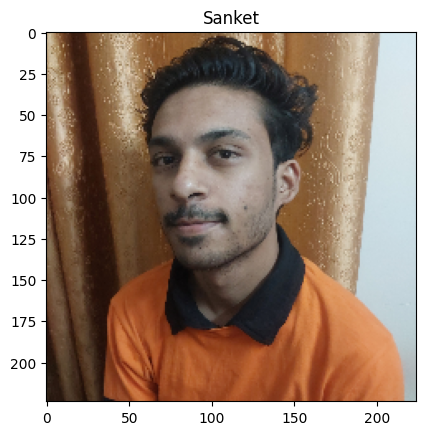

In [38]:
plt.title(nameDict[imgL])
plt.imshow(cv2.cvtColor(np.array(img.permute(1, 2, 0)), cv2.COLOR_BGR2RGB))

In [39]:
img , imgL = TestdataSet.__getitem__(8)

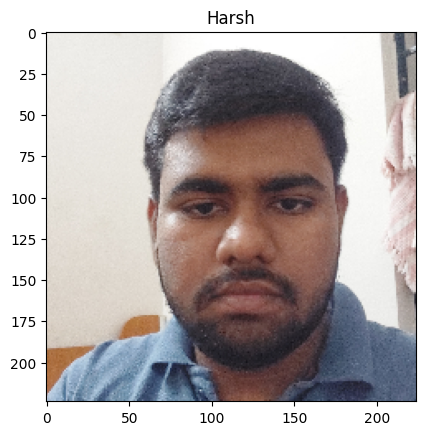

In [40]:
plt.title(nameDict[imgL])
plt.imshow(cv2.cvtColor(np.array(img.permute(1, 2, 0)), cv2.COLOR_BGR2RGB))

### Now we will train AutoEncoder
Using auto encoder we will be learning data distribution of images we will feeding into face recognition model<br>
We first train auto encoder on data we know is right to be fed into face recognition model <br>
Then we will form data such that it contain reconstruction error and label. That is if reconstruction error during test time was produced by data that belong to required data distribution we label that reconstruction as 0 meaning that images with that reconstruction error are not outlier. While reconstruction error obtained from images out side the required data distribution will labelled as 1 meaning that much amount of reconstruction is produced by image outside data distribution.

In [25]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
    #transforms.Normalize(mean = [0.5079, 0.5079, 0.5079], std = [0.2458, 0.2458, 0.2458])
])

In [13]:
train_data_CSV = "/kaggle/working/train_data.csv"
train_data = "/kaggle/input/train-test-combine/TrainCombine"
TrainDataSet = CustomImageDataset(train_data_CSV, train_data, transform)

In [14]:
BATCH_SIZE = 50
train_dataloader = DataLoader(dataset=TrainDataSet, batch_size=BATCH_SIZE, shuffle=True)

In [111]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 16, kernel_size=3, stride=2, padding=1),  # 112x112
            nn.ReLU(True),
            nn.Conv2d(16, 32, kernel_size=3, stride=2, padding=1),  # 56x56
            nn.ReLU(True),
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),  # 28x28
            nn.ReLU(True),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 14x14
            nn.ReLU(True)
        )
        
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),  # 28x28
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),  # 56x56
            nn.ReLU(True),
            nn.ConvTranspose2d(32, 16, kernel_size=3, stride=2, padding=1, output_padding=1),  # 112x112
            nn.ReLU(True),
            nn.ConvTranspose2d(16, 3, kernel_size=3, stride=2, padding=1, output_padding=1),  # 224x224
            nn.Sigmoid()
        )
    
    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

In [56]:
lossArr = []

Epoch [1/150], Loss: 0.0597


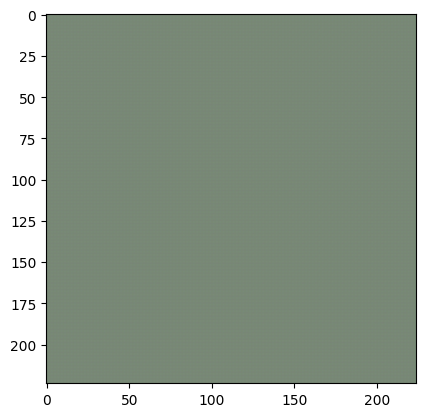

Epoch [2/150], Loss: 0.0587


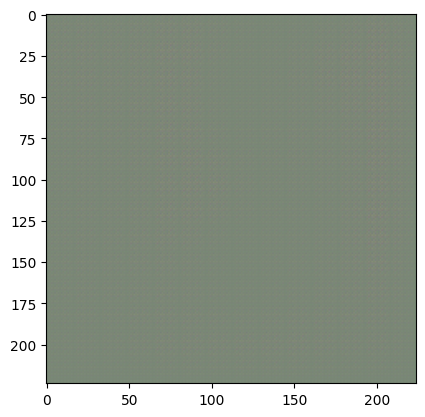

Epoch [3/150], Loss: 0.0627


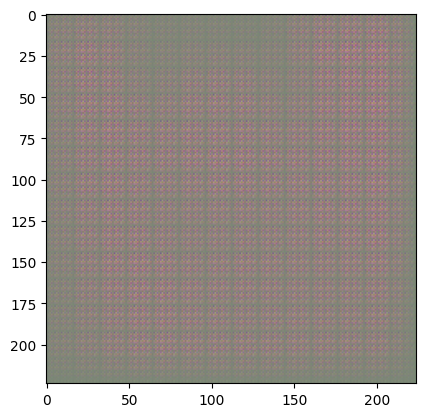

Epoch [4/150], Loss: 0.0545


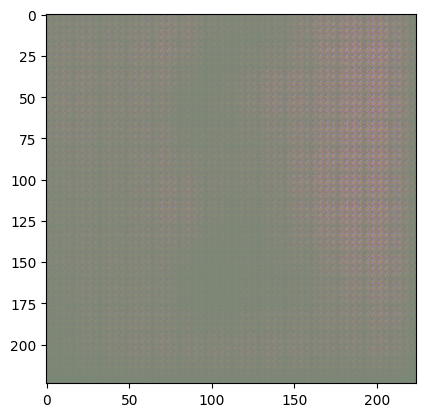

Epoch [5/150], Loss: 0.0509


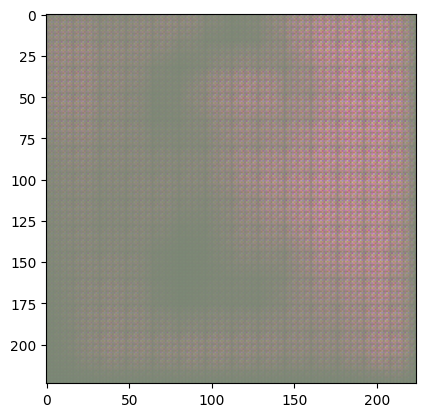

Epoch [6/150], Loss: 0.0497


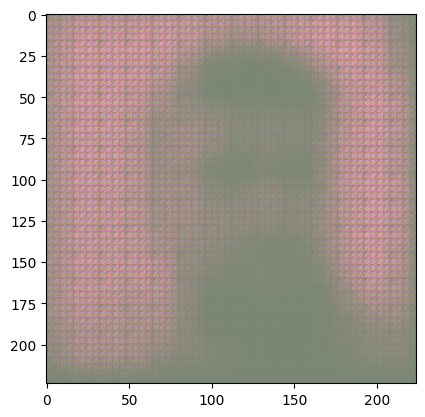

Epoch [7/150], Loss: 0.0456


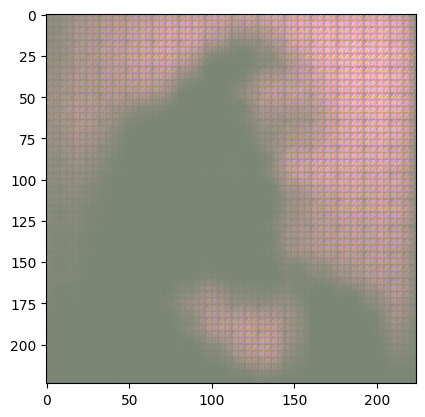

Epoch [8/150], Loss: 0.0362


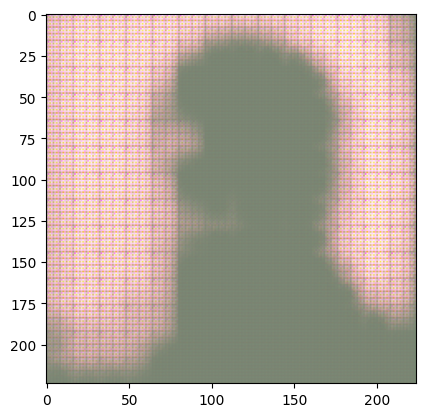

Epoch [9/150], Loss: 0.0346


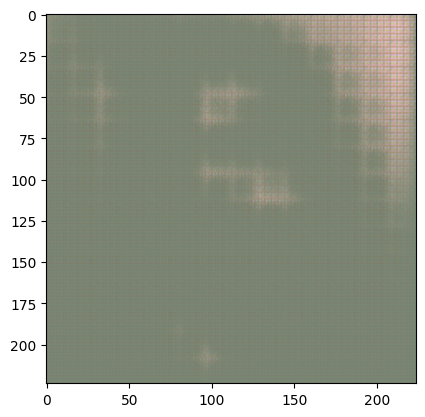

Epoch [10/150], Loss: 0.0321


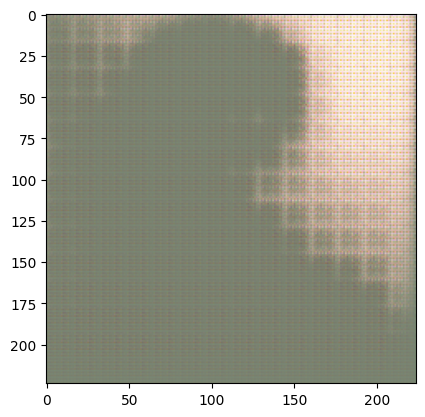

Epoch [11/150], Loss: 0.0328


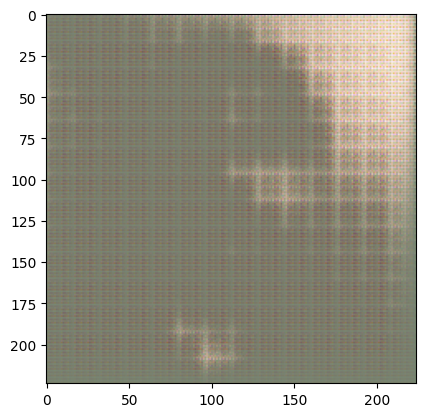

Epoch [12/150], Loss: 0.0272


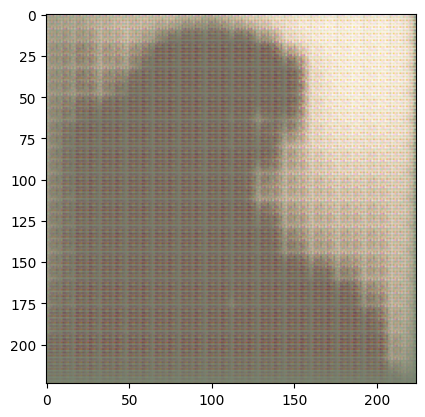

Epoch [13/150], Loss: 0.0238


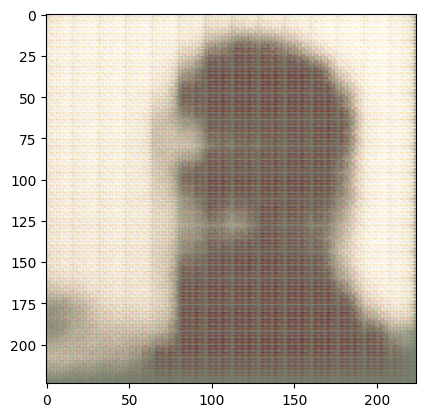

Epoch [14/150], Loss: 0.0216


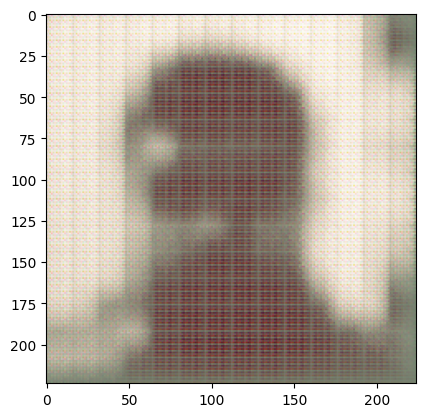

Epoch [15/150], Loss: 0.0175


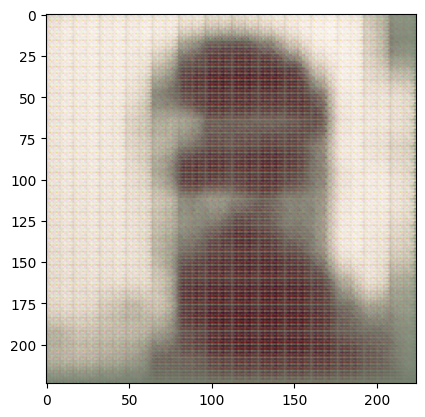

Epoch [16/150], Loss: 0.0155


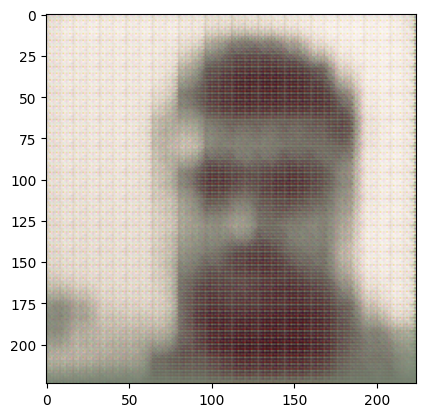

Epoch [17/150], Loss: 0.0139


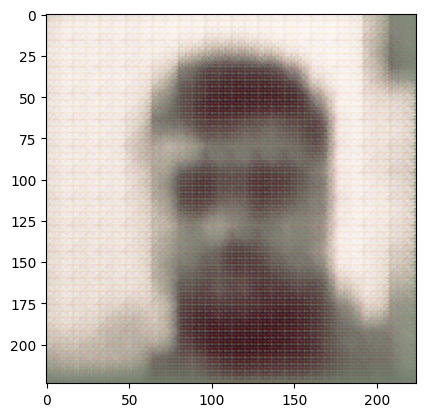

Epoch [18/150], Loss: 0.0123


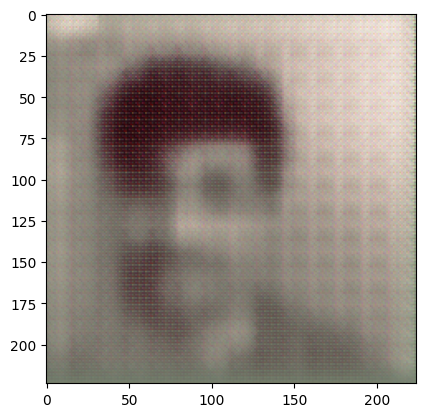

Epoch [19/150], Loss: 0.0114


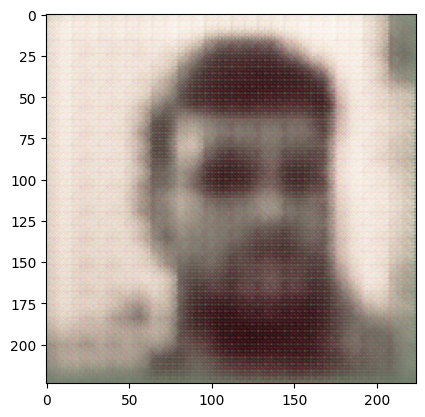

Epoch [20/150], Loss: 0.0117


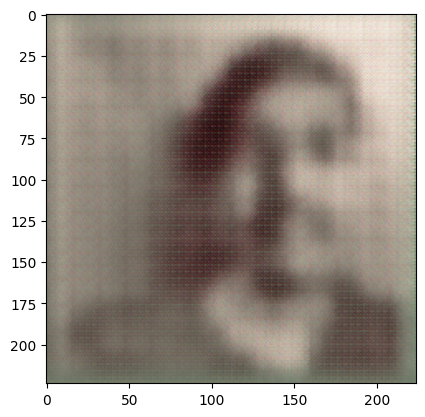

Epoch [21/150], Loss: 0.0103


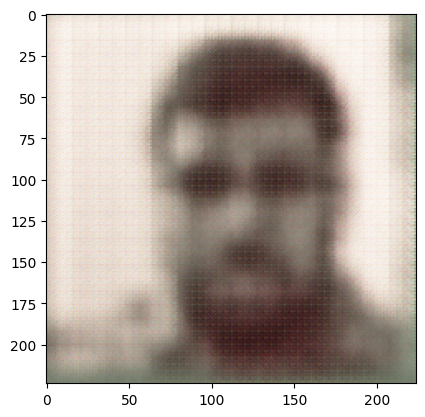

Epoch [22/150], Loss: 0.0093


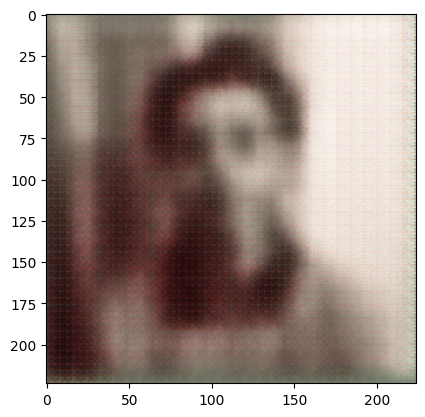

Epoch [23/150], Loss: 0.0098


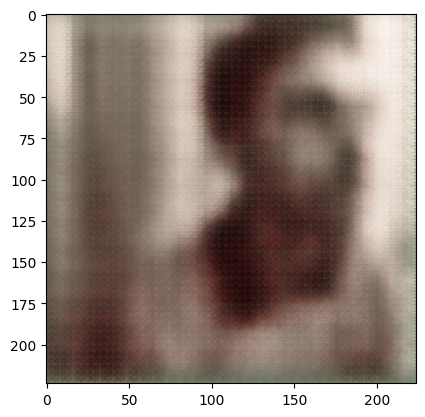

Epoch [24/150], Loss: 0.0090


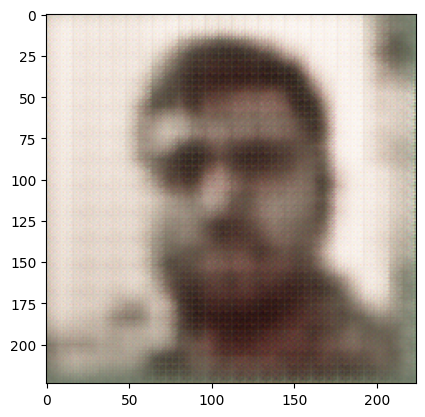

Epoch [25/150], Loss: 0.0087


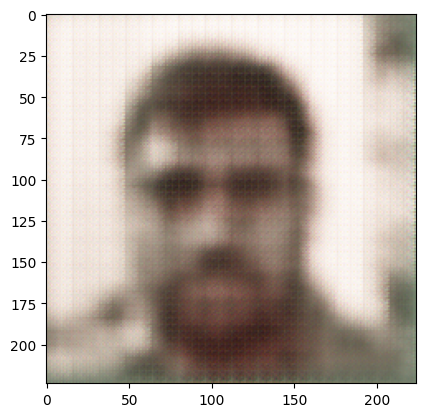

Epoch [26/150], Loss: 0.0086


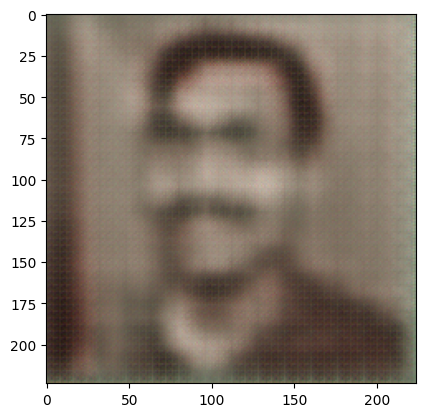

Epoch [27/150], Loss: 0.0078


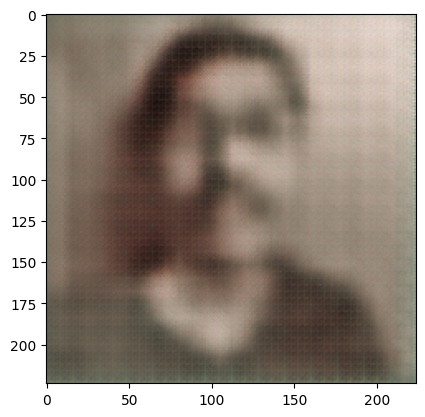

Epoch [28/150], Loss: 0.0073


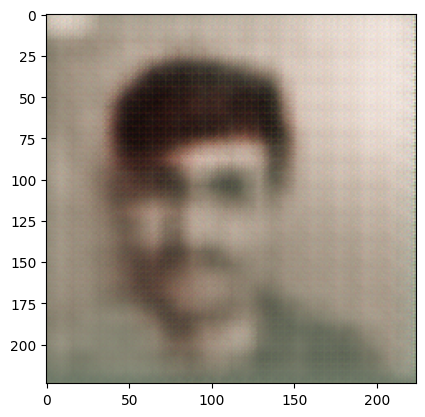

Epoch [29/150], Loss: 0.0070


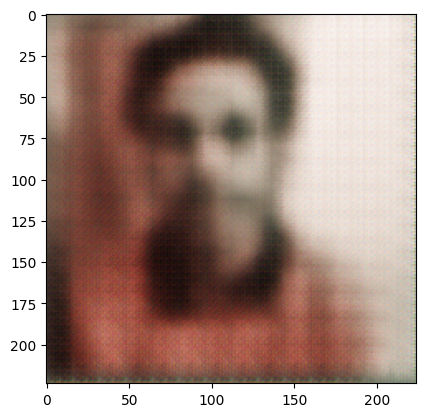

Epoch [30/150], Loss: 0.0071


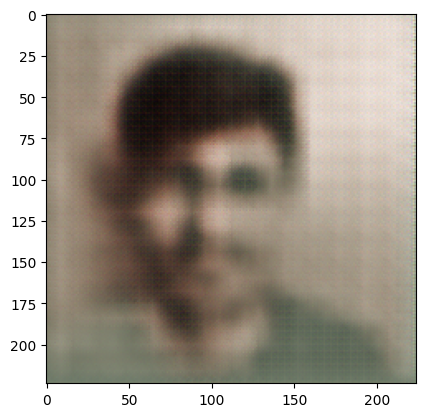

Epoch [31/150], Loss: 0.0070


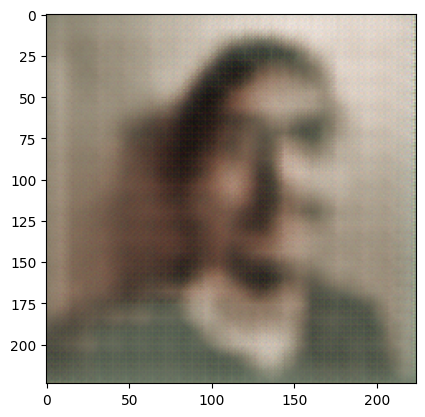

Epoch [32/150], Loss: 0.0072


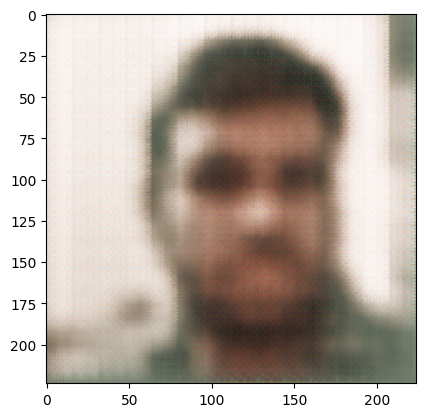

Epoch [33/150], Loss: 0.0064


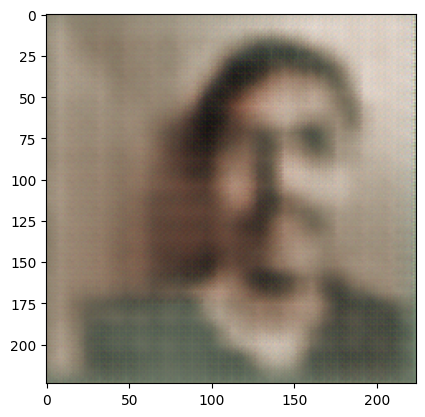

Epoch [34/150], Loss: 0.0067


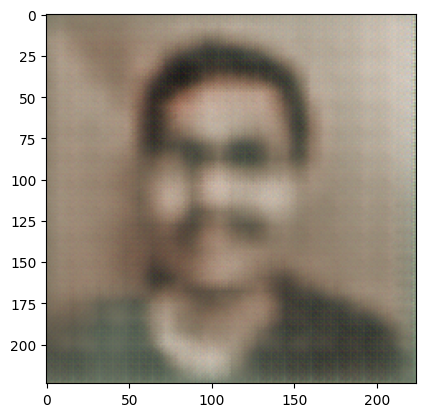

Epoch [35/150], Loss: 0.0062


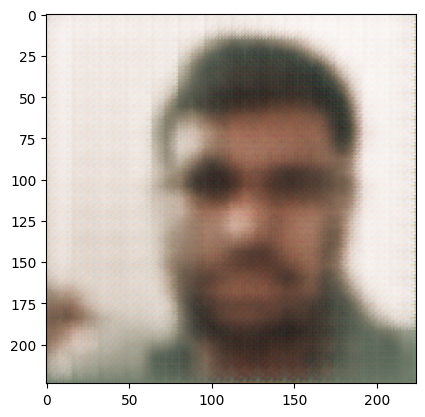

Epoch [36/150], Loss: 0.0060


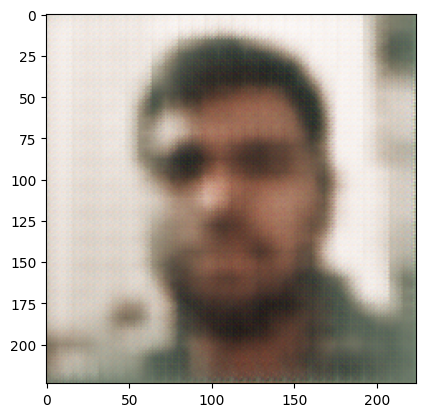

Epoch [37/150], Loss: 0.0063


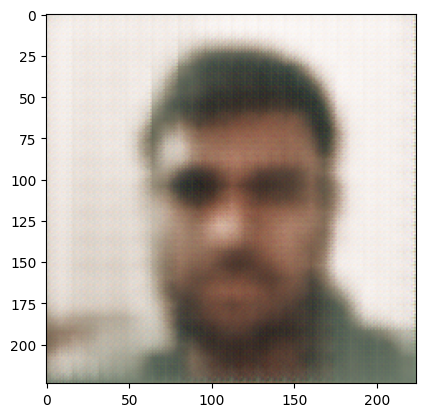

Epoch [38/150], Loss: 0.0061


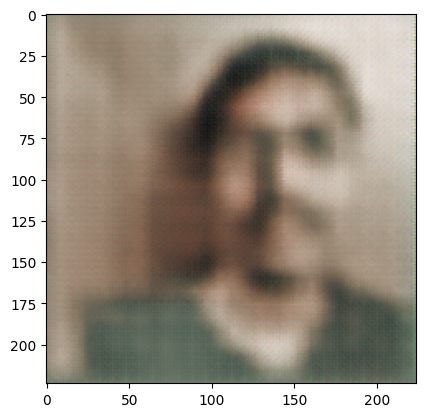

Epoch [39/150], Loss: 0.0055


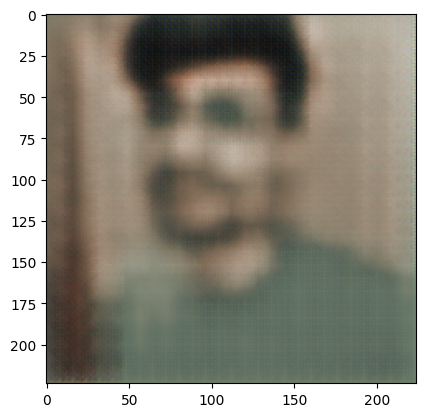

Epoch [40/150], Loss: 0.0054


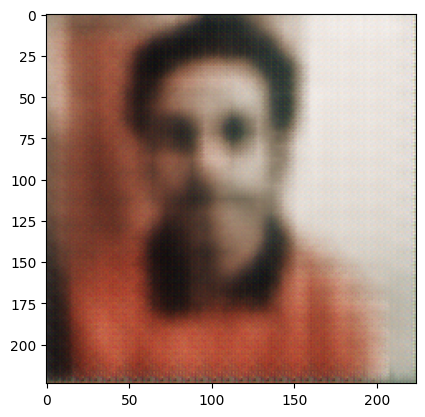

Epoch [41/150], Loss: 0.0054


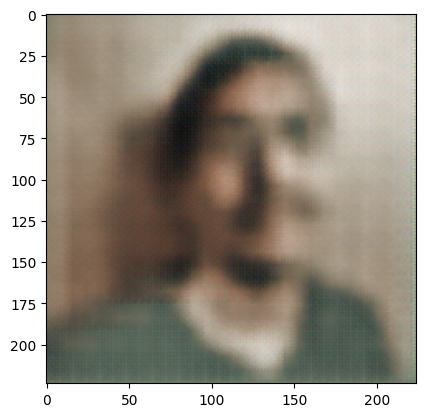

Epoch [42/150], Loss: 0.0054


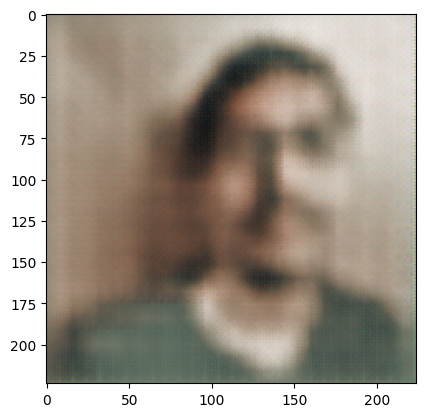

Epoch [43/150], Loss: 0.0061


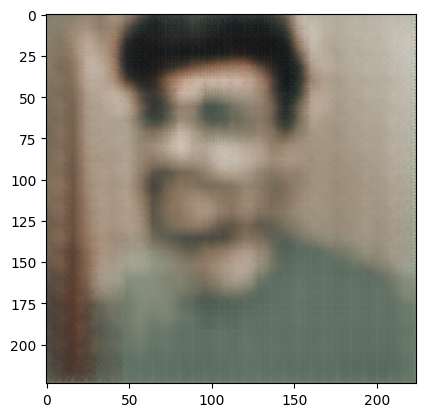

Epoch [44/150], Loss: 0.0055


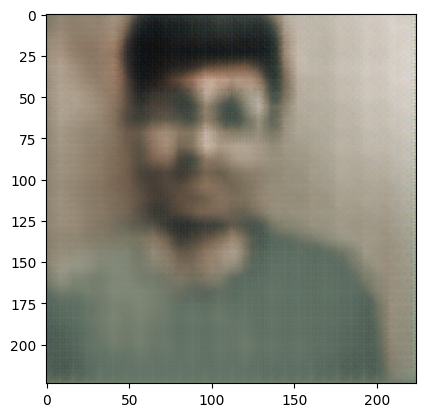

Epoch [45/150], Loss: 0.0056


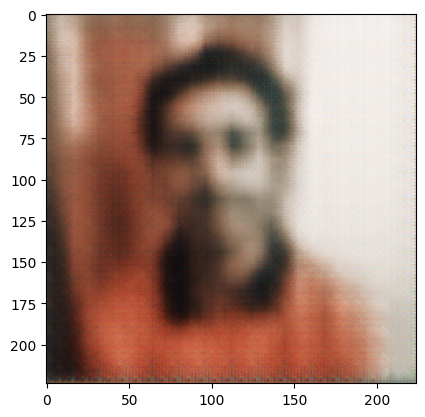

Epoch [46/150], Loss: 0.0059


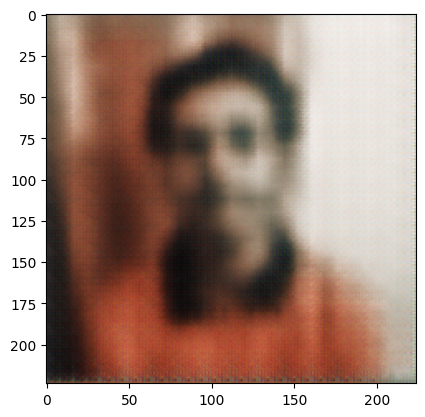

Epoch [47/150], Loss: 0.0052


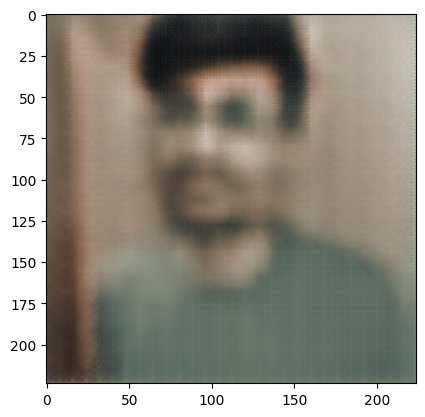

Epoch [48/150], Loss: 0.0052


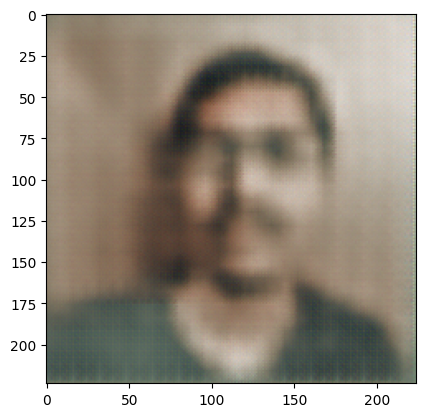

Epoch [49/150], Loss: 0.0049


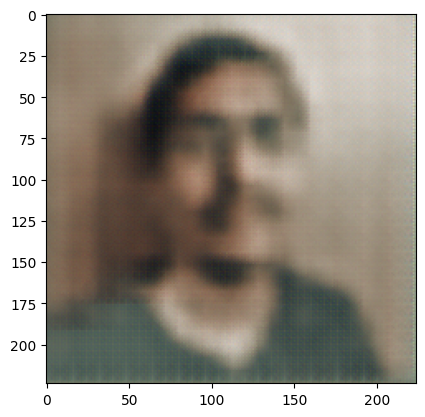

Epoch [50/150], Loss: 0.0048


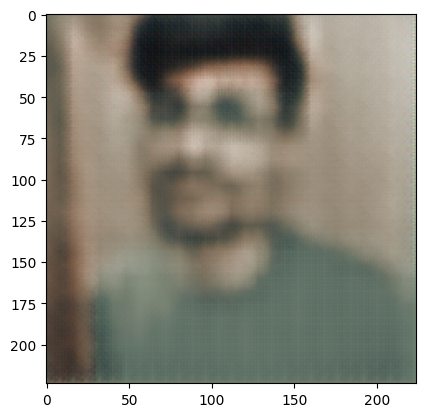

Epoch [51/150], Loss: 0.0049


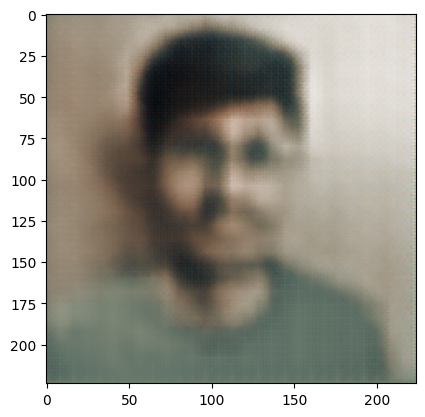

Epoch [52/150], Loss: 0.0050


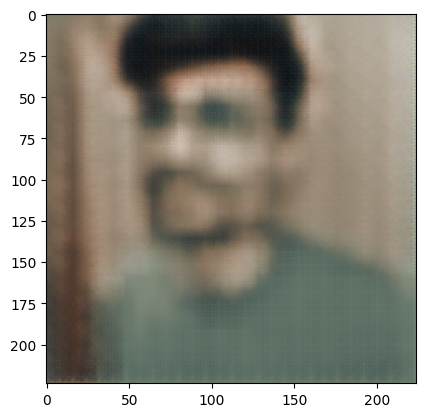

Epoch [53/150], Loss: 0.0050


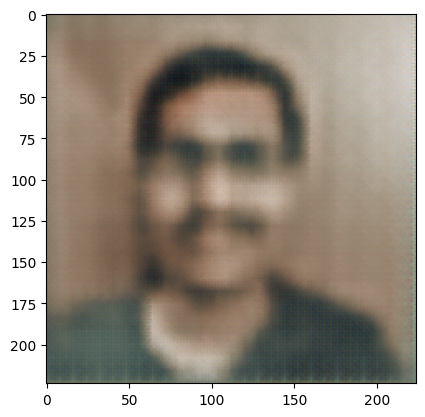

Epoch [54/150], Loss: 0.0049


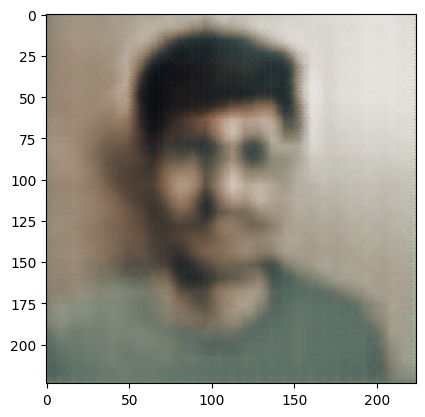

Epoch [55/150], Loss: 0.0047


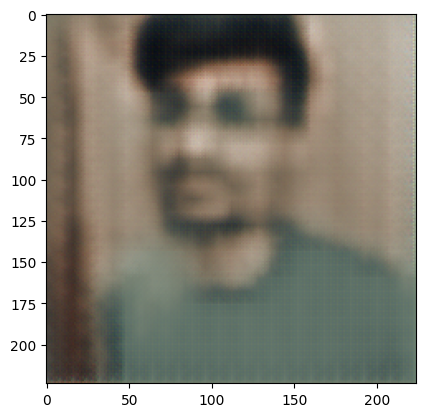

Epoch [56/150], Loss: 0.0044


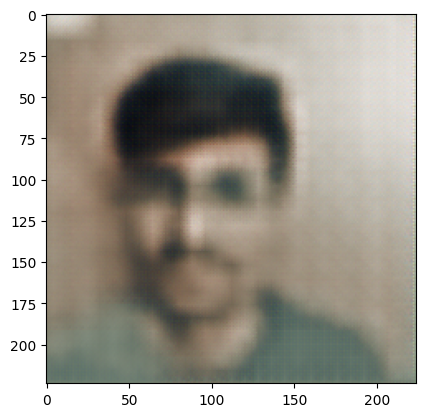

Epoch [57/150], Loss: 0.0046


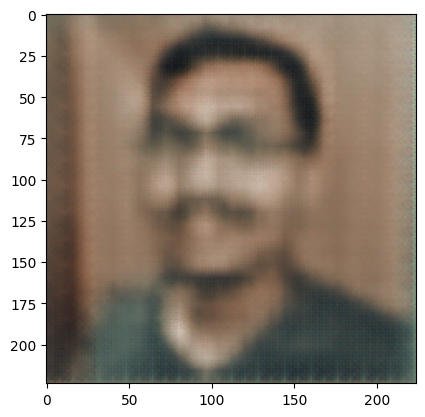

Epoch [58/150], Loss: 0.0045


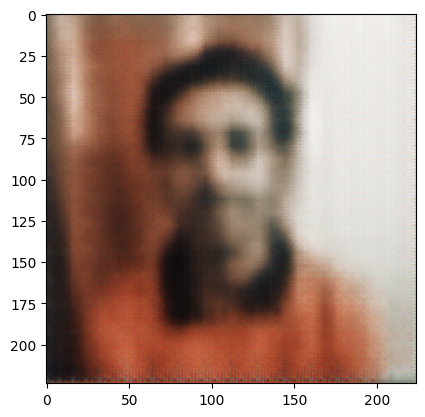

Epoch [59/150], Loss: 0.0051


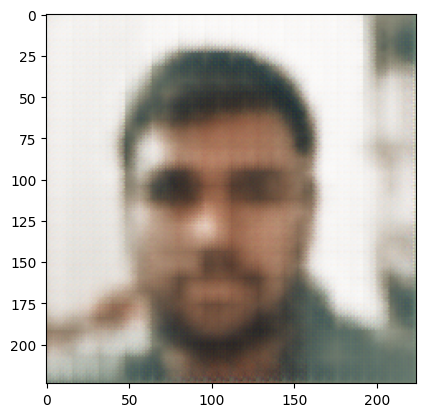

Epoch [60/150], Loss: 0.0050


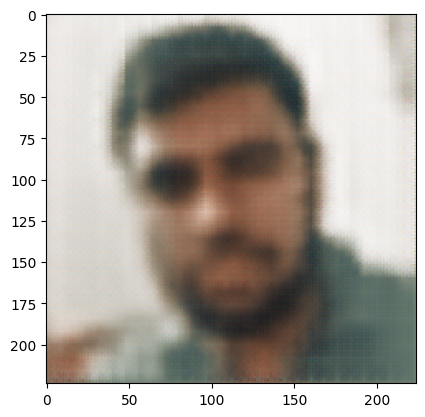

KeyboardInterrupt: 

In [57]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

modelAuto = Autoencoder()

modelAuto.to(device)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(modelAuto.parameters(), lr=0.001)

num_epochs = 150
for epoch in range(num_epochs):
    for data in train_dataloader:
        img, _ = data
        img = img.to(device)
        
        # Forward pass
        output = modelAuto(img)
        loss = criterion(output, img)
        
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    
    # Print loss after every epoch
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")
    lossArr.append(loss.item)
    
    # Save reconstructed images
    #if (epoch+1) % 5 == 0:
     #   recon_images = output.cpu().detach()
     #   save_image(recon_images, f"reconstructed_epoch_{epoch+1}.png")
    for data in train_dataloader:
        img, _ = data
        img = img.to(device)
    
        modelAuto.eval()
    
        with torch.no_grad():
            out = modelAuto(img)
            plt.imshow(cv2.cvtColor(np.array(out[0].permute(1, 2, 0).cpu()), cv2.COLOR_BGR2RGB))
            plt.show()
        break

In [20]:
def reconstruction_error(model, input_tensor):
    model.eval()
    with torch.no_grad():
        reconstructed_output = model(input_tensor)
    
    criterion = nn.MSELoss()
    mse_loss = criterion(reconstructed_output, input_tensor)
    
    return mse_loss.item()

In [ ]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(modelAuto.parameters(), lr=0.0001)

Epoch [1/10], Loss: 0.0046


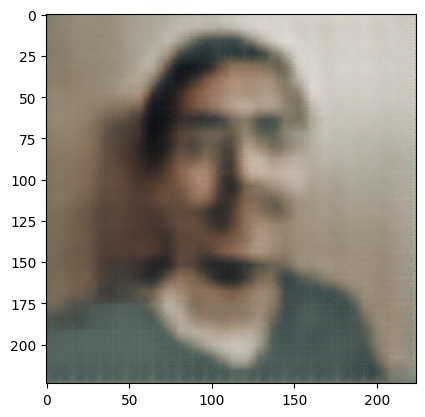

Epoch [2/10], Loss: 0.0046


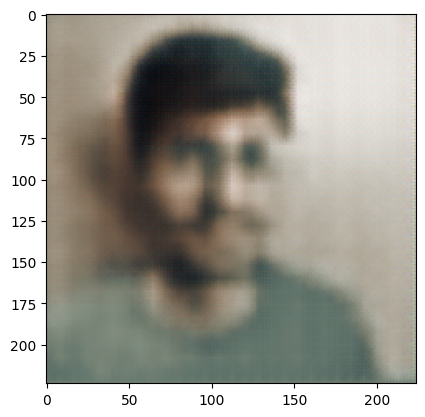

Epoch [3/10], Loss: 0.0048


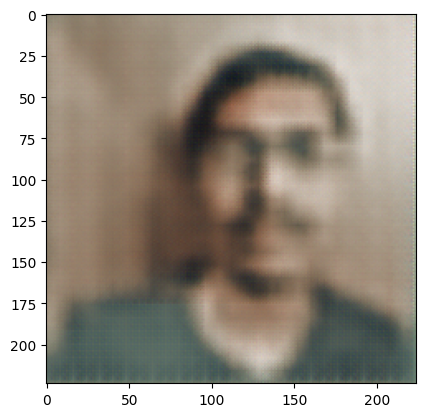

Epoch [4/10], Loss: 0.0046


KeyboardInterrupt: 

In [60]:
num_epochs = 10
for epoch in range(num_epochs):
    for data in train_dataloader:
        img, _ = data
        img = img.to(device)
        
        # Forward pass
        output = modelAuto(img)
        loss = criterion(output, img)
        
        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    
    # Print loss after every epoch
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")
    lossArr.append(loss.item)
    
    # Save reconstructed images
    #if (epoch+1) % 5 == 0:
     #   recon_images = output.cpu().detach()
     #   save_image(recon_images, f"reconstructed_epoch_{epoch+1}.png")
    for data in train_dataloader:
        img, _ = data
        img = img.to(device)
    
        modelAuto.eval()
    
        with torch.no_grad():
            out = modelAuto(img)
            plt.imshow(cv2.cvtColor(np.array(out[0].permute(1, 2, 0).cpu()), cv2.COLOR_BGR2RGB))
            plt.show()
        break

Training auto encoder till the time we don't get viewable reconstructed image

In [61]:
torch.save(modelAuto.state_dict(), "autoencoder.pth")

In [112]:
modelAuto = Autoencoder()
modelAuto.load_state_dict(torch.load("/kaggle/input/modelauto/pytorch/auto.pth/1/autoencoder (2).pth"))

<All keys matched successfully>

In [29]:
dataReconstruction = {
    "ReconstructionError" : [],
    "label_outlier" : []
}

In [24]:
autoEncoderTest = "/kaggle/input/imagesforq3/Q3/TestAutoEncoder"

In [30]:
for imgAuto in os.listdir(autoEncoderTest):
    img_path = os.path.join(autoEncoderTest, imgAuto)
    image = cv2.imread(img_path)
    img_pro = transform(image)
    dataReconstruction["ReconstructionError"].append(reconstruction_error(modelAuto, img_pro))
    dataReconstruction["label_outlier"].append(0)

In [31]:
pd.DataFrame(dataReconstruction)

,ReconstructionError,label_outlier
0,0.006733,0
1,0.004778,0
2,0.006612,0
3,0.002181,0
4,0.002184,0
...,...,...
95,0.005009,0
96,0.002291,0
97,0.002232,0
98,0.006554,0


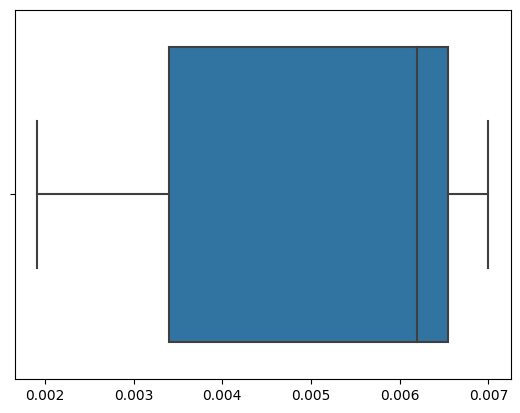

In [34]:
sns.boxplot(dataReconstruction, x = "ReconstructionError")
plt.show()

In [35]:
outlier_directory = "/kaggle/input/imagesforq3/Q3/RandomImages100"
for imgAuto in os.listdir(outlier_directory):
    img_path = os.path.join(outlier_directory, imgAuto)
    image = cv2.imread(img_path)
    img_pro = transform(image)
    dataReconstruction["ReconstructionError"].append(reconstruction_error(modelAuto, img_pro))
    dataReconstruction["label_outlier"].append(1)

/opt/conda/lib/python3.10/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


In [40]:
dfReconstruction = pd.DataFrame(dataReconstruction)
dfReconstruction[dfReconstruction["label_outlier"] == 1]

,ReconstructionError,label_outlier
100,0.018396,1
101,0.010402,1
102,0.017074,1
103,0.025777,1
104,0.013175,1
...,...,...
195,0.011725,1
196,0.020551,1
197,0.018010,1
198,0.029141,1


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


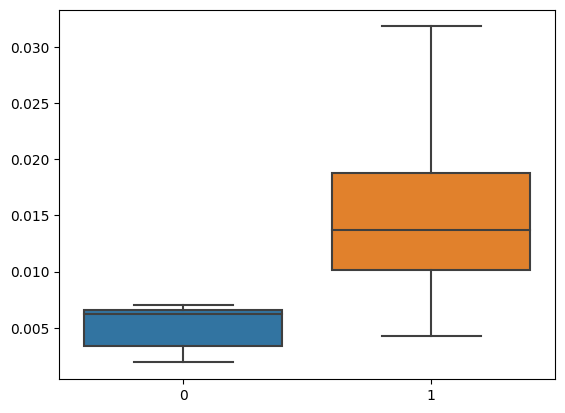

In [38]:
sns.boxplot(dataReconstruction, y = "ReconstructionError", x = "label_outlier")
plt.show()

### Reconstruction error distribution
1 represents reconstruction error of those image out side the required data distribution,
0 for the images which are in required data distribution

In [42]:
dfReconstruction.to_csv("dfReconstruction.csv", index = False)

In [47]:
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

In [77]:
X = dfReconstruction.drop('label_outlier', axis=1)  # Features
y = dfReconstruction['label_outlier'] 

In [90]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

In [91]:
clf = svm.SVC(kernel = 'poly', degree = 3)  
clf.fit(X_train, y_train)

SVC(kernel='poly')

In [94]:
import pickle

with open('svm_model.pkl', 'wb') as f:
    pickle.dump(clf, f)

In [92]:
y_pred = clf.predict(X_test)

In [93]:
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.95


With help of autoencoder and SVM we get 95% accuracy in deciding if given image is outlier or not

In [15]:
import pickle

with open('/kaggle/input/svmoutlier/scikitlearn/svmoutlier.pkl/1/svm_model.pkl', 'rb') as f:
    clf = pickle.load(f)

In [130]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224)),
    transforms.Normalize(mean = [0.5079, 0.5079, 0.5079], std = [0.2458, 0.2458, 0.2458])
])

In [131]:
train_data_CSV = "/kaggle/working/train_data.csv"
train_data = "/kaggle/input/train-test-combine/TrainCombine"
TrainDataSet = CustomImageDataset(train_data_CSV, train_data, transform)

In [132]:
test_data_CSV = "/kaggle/working/test_data.csv"
test_data = "/kaggle/input/train-test-combine/TestCombine"
TestDataSet = CustomImageDataset(test_data_CSV, test_data, transform)

In [133]:
BATCH_SIZE = 50
train_dataloader = DataLoader(dataset=TrainDataSet, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = DataLoader(dataset=TestDataSet, batch_size=BATCH_SIZE, shuffle=True)

In [152]:
from torchvision import models

model = models.resnet18(weights='IMAGENET1K_V1')

num_features = model.fc.in_features

## Freezing the layers
for param in model.parameters():
    if isinstance(param, nn.Conv2d):
        param.requires_grad = False
        
## Adding Extra layers
model.fc = nn.Sequential(
    nn.Linear(num_features, 256),  
    nn.ReLU(),         
    nn.Linear(256, 4)   
)
print(model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [153]:
import torch.optim as optim

optimizer = optim.Adam(model.parameters(), lr=0.0001, weight_decay=0.0001)
loss_fn = nn.CrossEntropyLoss()

### Model for detecting whose photo it is

cuda
Epoch 1/5 | Batch 0/4 | Loss: 1.3247
Epoch 1/5 | Batch 1/4 | Loss: 1.0116
Epoch 1/5 | Batch 2/4 | Loss: 0.7339
Epoch 1/5 | Batch 3/4 | Loss: 0.5595


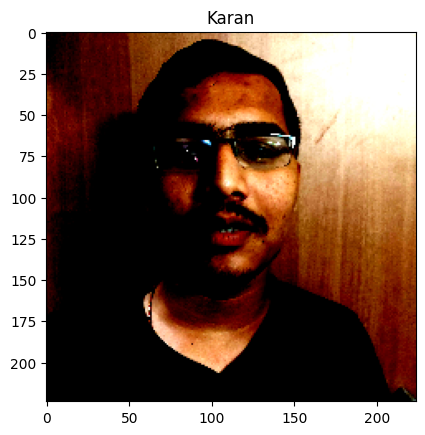

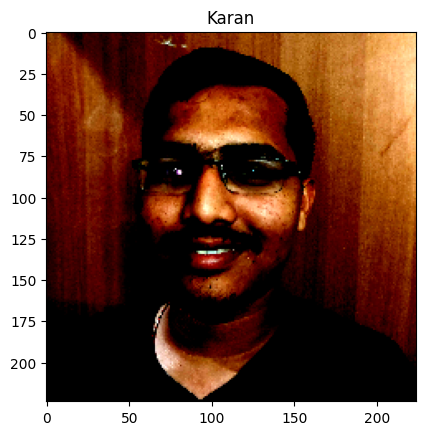

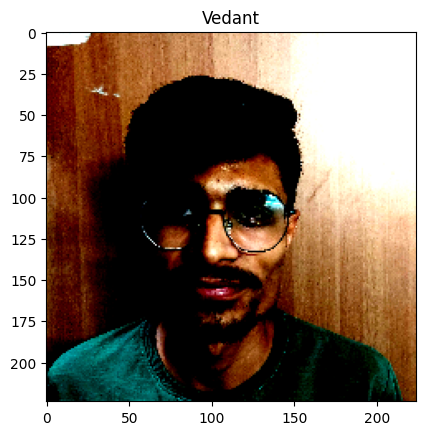

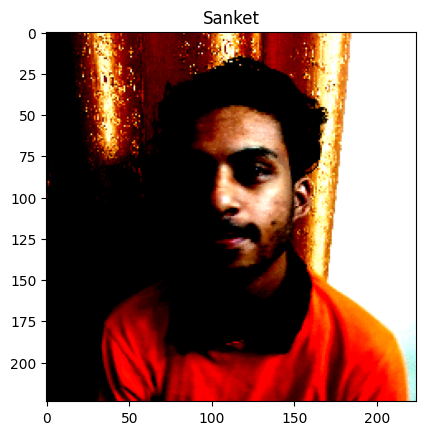

Accuracy on the test set: 100.000000 %
Accuracy on the train set: 100.000000 %
Epoch 2/5 | Batch 0/4 | Loss: 0.6428
Epoch 2/5 | Batch 1/4 | Loss: 0.2462
Epoch 2/5 | Batch 2/4 | Loss: 0.1229
Epoch 2/5 | Batch 3/4 | Loss: 0.0533


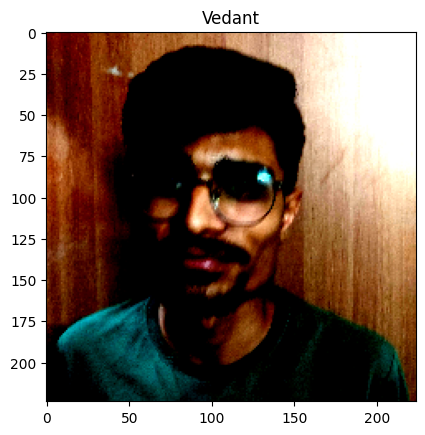

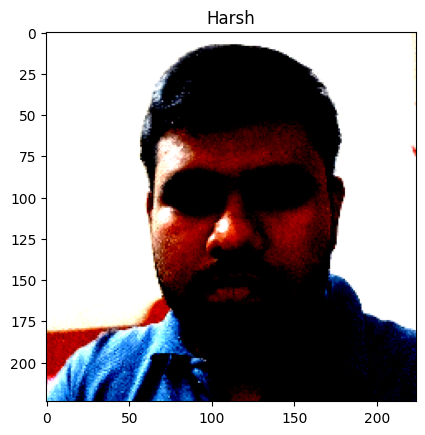

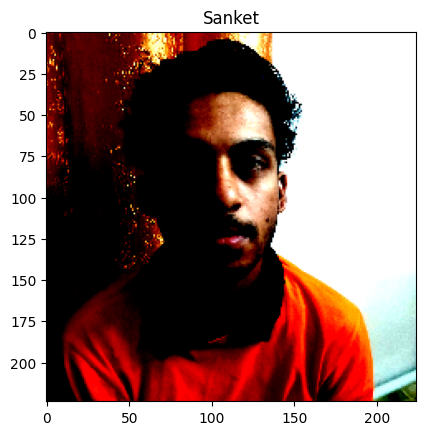

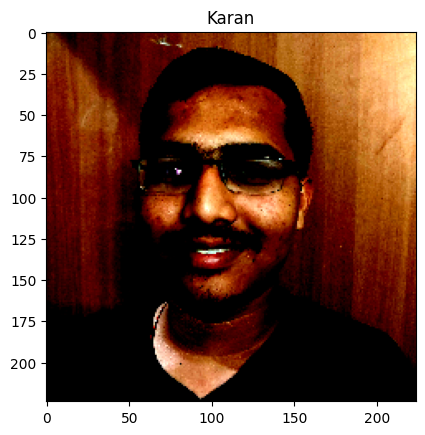

Accuracy on the test set: 100.000000 %
Accuracy on the train set: 100.000000 %
Epoch 3/5 | Batch 0/4 | Loss: 0.0075
Epoch 3/5 | Batch 1/4 | Loss: 0.0048
Epoch 3/5 | Batch 2/4 | Loss: 0.0228
Epoch 3/5 | Batch 3/4 | Loss: 0.0025


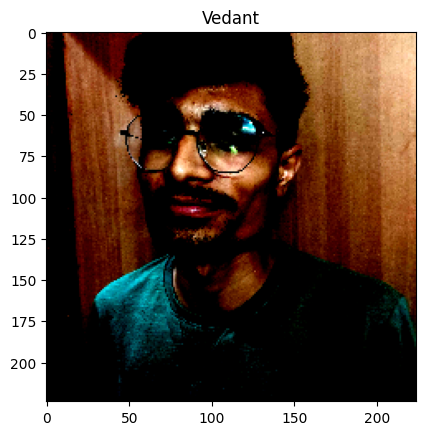

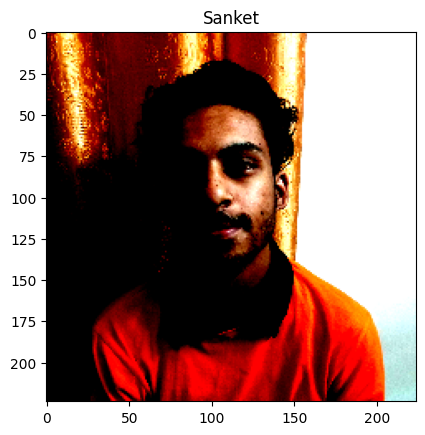

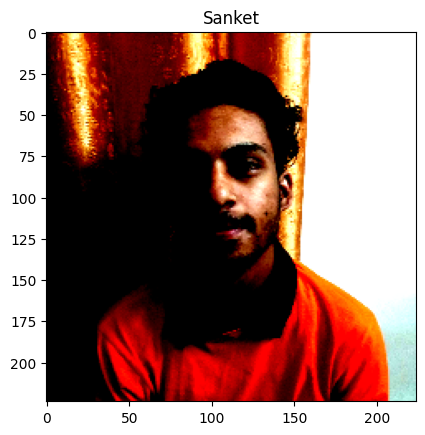

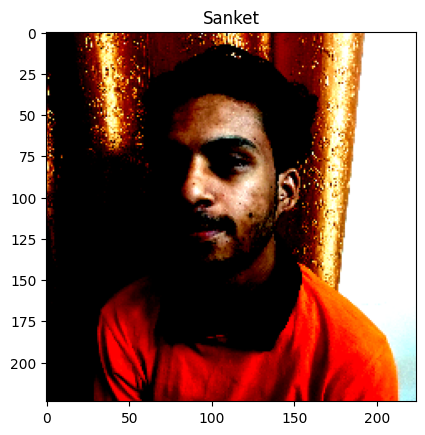

Accuracy on the test set: 100.000000 %
Accuracy on the train set: 100.000000 %
Epoch 4/5 | Batch 0/4 | Loss: 0.0010
Epoch 4/5 | Batch 1/4 | Loss: 0.0006
Epoch 4/5 | Batch 2/4 | Loss: 0.0025
Epoch 4/5 | Batch 3/4 | Loss: 0.0003


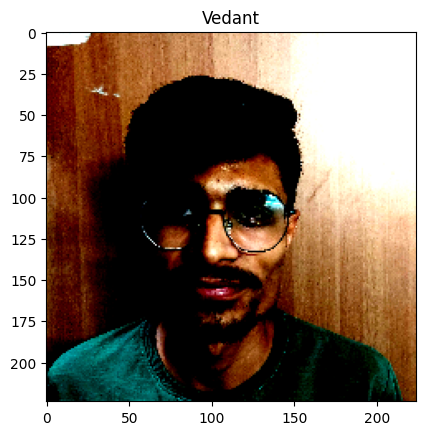

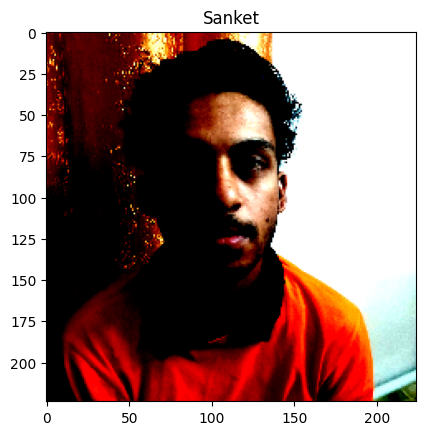

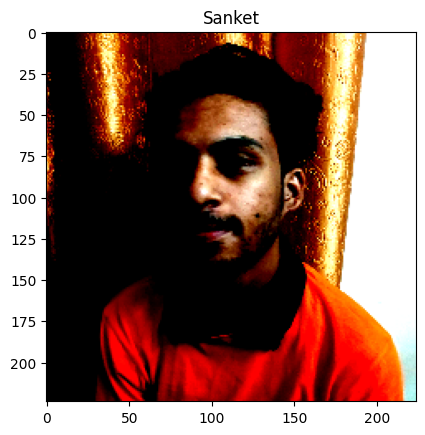

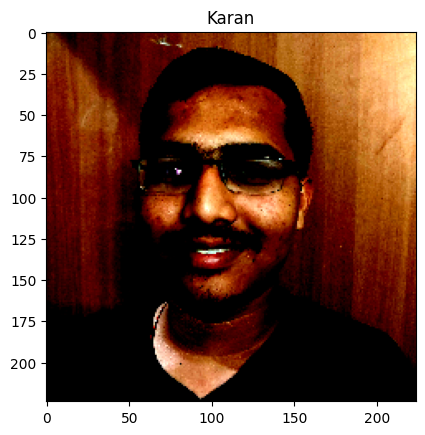

Accuracy on the test set: 100.000000 %
Accuracy on the train set: 100.000000 %
Epoch 5/5 | Batch 0/4 | Loss: 0.0001
Epoch 5/5 | Batch 1/4 | Loss: 0.0002
Epoch 5/5 | Batch 2/4 | Loss: 0.0002
Epoch 5/5 | Batch 3/4 | Loss: 0.0010


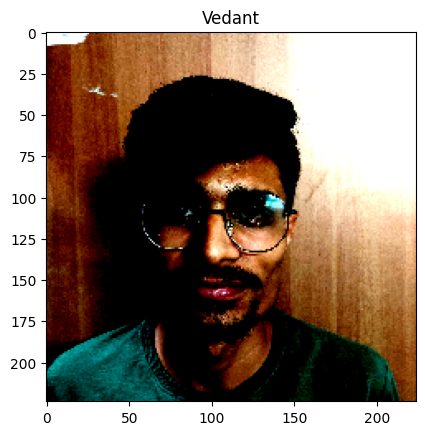

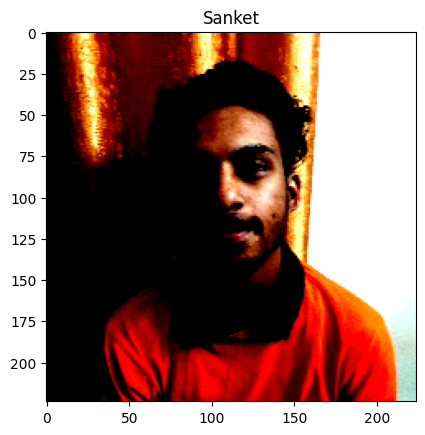

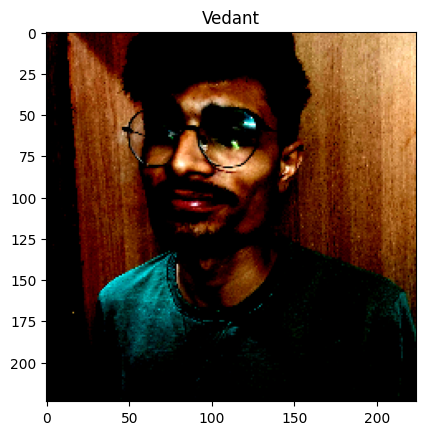

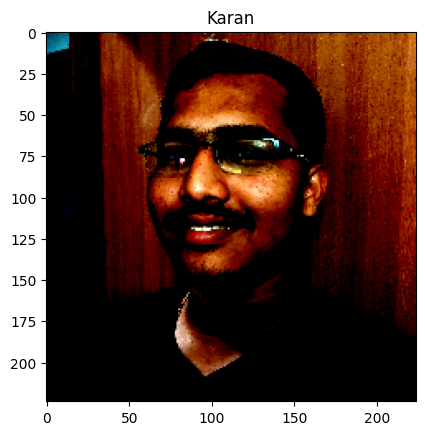

Accuracy on the test set: 100.000000 %
Accuracy on the train set: 100.000000 %


In [154]:
num_epochs = 5
lossArr = []
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
model.to(device)

for epoch in range(num_epochs):
    for batch_idx, (data, targets) in enumerate(train_dataloader):
        data, targets = data.to(device), targets.to(device)
        
        # Zero the gradients
        optimizer.zero_grad()

        outputs = model(data)
        # targets = torch.max(targets, 1)
        loss = loss_fn(outputs, targets)

        loss.backward()

        optimizer.step()

        if batch_idx % 1 == 0:
            print(f"Epoch {epoch+1}/{num_epochs} | Batch {batch_idx}/{len(train_dataloader)} | Loss: {loss.item():.4f}")
            lossArr.append(loss.item())
    torch.save(model, f"model{epoch}.pth")
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for data, target in test_dataloader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            _, predicted = torch.max(output.data, 1)
            plt.title(nameDict[predicted[20].item()])
            plt.imshow(cv2.cvtColor(np.array(data[20].permute(1, 2, 0).cpu()), cv2.COLOR_BGR2RGB))
            plt.show()
            plt.title(nameDict[predicted[0].item()])
            plt.imshow(cv2.cvtColor(np.array(data[0].permute(1, 2, 0).cpu()), cv2.COLOR_BGR2RGB))
            plt.show()
            plt.title(nameDict[predicted[30].item()])
            plt.imshow(cv2.cvtColor(np.array(data[30].permute(1, 2, 0).cpu()), cv2.COLOR_BGR2RGB))
            plt.show()
            plt.title(nameDict[predicted[15].item()])
            plt.imshow(cv2.cvtColor(np.array(data[15].permute(1, 2, 0).cpu()), cv2.COLOR_BGR2RGB))
            plt.show()
            total += target.size(0)
            correct += (predicted == target).sum().item()

    print('Accuracy on the test set: %f %%' % (100* correct / total))
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for data, target in train_dataloader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            _, predicted = torch.max(output.data, 1)
            total += target.size(0)
            correct += (predicted == target).sum().item()

    print('Accuracy on the train set: %f %%' % (100* correct / total))

In [11]:
model = torch.load("/kaggle/input/facerecog/pytorch/modelfacerecog.pth/1/model4.pth")

In [114]:
transform1 = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224), antialias = True)
])

In [115]:
transform2 = transforms.Compose([
    transforms.Normalize(mean = [0.5079, 0.5079, 0.5079], std = [0.2458, 0.2458, 0.2458])
])

Consolidated function which when given an image predicts whose face it is if image is in required data distribution and declares it has outlier if image donot follow data distribution of training dataset of face recognition model

In [54]:
def ClassifyImage(image):
    ImgProcessed1 = transform1(image)
    reconstructionError = reconstruction_error(modelAuto, ImgProcessed1)
    df = pd.DataFrame(np.array(reconstructionError).reshape(-1, 1))
    df.columns = ['ReconstructionError']
    flag = clf.predict(df)
    if flag:
        print("Outlier Detected")
    else :
        ImageProcessed2 = transform2(ImgProcessed1)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        output = model(ImageProcessed2.to(device).expand(1, 3, 224, 224))
        _, predicted = torch.max(output.data, 1)
        print(f"Its is {nameDict[predicted.item()]} photo")

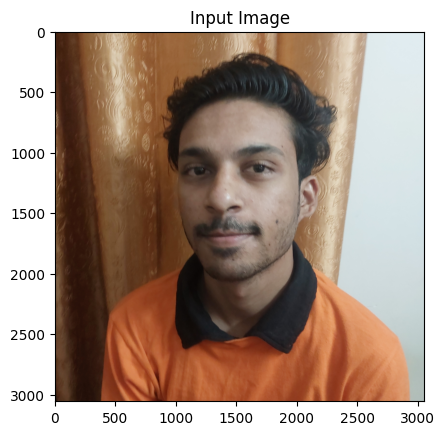

Its is Sanket photo


In [55]:
image = cv2.imread("/kaggle/input/train-test-combine/TestCombine/20240413_230100_020.jpg")
plt.title("Input Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()
ClassifyImage(image)

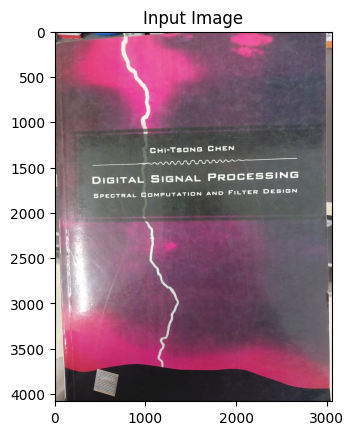

Outlier Detected


In [57]:
image = cv2.imread("/kaggle/input/imagesforq3/Q3/RandomImages100/20221012_171738.jpg")
plt.title("Input Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()
ClassifyImage(image)

In [12]:
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [13]:
model1 = torch.nn.Sequential(*list(model.children())[:-1]) 

In [21]:
summary(model1, (3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

### Using SVM only to detect if given image is outlier or not
We form image embedding using trained model of face detection by removing last fully connected layer. <br>
Now image embeddings are label 0 if image is not outlier to dataset and 1 if image is outlier(image is out of data distribution).<br>
Then we use image embedding and label to train SVM. So given an image embedding it can predict whether it is outlier or not

In [64]:
transformEmbedd = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224), antialias = True)
])

In [90]:
dataEmbedding = {
    'label_outlier' : []
}

In [91]:
for i in range(512):
    dataEmbedding[i] = []

In [92]:
outlier_directory = "/kaggle/input/imagesforq3/Q3/RandomImages100"
for imgAuto in os.listdir(outlier_directory):
    img_path = os.path.join(outlier_directory, imgAuto)
    image = cv2.imread(img_path)
    img_pro = transformEmbedd(image)
    model1.eval()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    with torch.no_grad():
        embedding = model1(img_pro.to(device).expand(1, 3, 224, 224))
    image_embedding = embedding.cpu().squeeze().numpy()
    for i, j in enumerate(image_embedding):
        dataEmbedding[i].append(j) 
    dataEmbedding["label_outlier"].append(1)

In [93]:
pd.DataFrame(dataEmbedding)

,label_outlier,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
0,1,0.614586,0.460558,4.904364,7.750508,1.226735,3.256696,2.143991,0.457136,1.067966,...,9.476132,21.524378,5.979614,8.158628,0.165940,13.191477,0.293496,0.000000,0.010528,3.241709
1,1,0.395022,1.927100,4.502409,6.073625,7.535651,1.027144,4.078490,4.239030,0.479628,...,9.029050,13.358547,3.250015,6.661176,2.516544,13.285115,3.956737,0.000352,2.222714,3.838114
2,1,1.108172,1.495887,4.653213,8.840697,15.779405,4.506788,11.898894,0.921727,1.792610,...,9.196348,14.369329,2.591194,2.557705,1.638882,14.205462,4.226543,0.084745,3.166010,4.205339
3,1,0.723183,2.105912,7.300818,6.677999,5.228872,2.700506,8.727939,0.194275,1.165300,...,13.106605,14.785161,5.229397,5.372590,1.645370,13.525061,2.002447,0.000000,2.731357,5.141812
4,1,0.785736,2.054786,5.605754,7.077763,2.332664,5.034605,2.843415,0.170524,0.093546,...,9.498379,22.675528,5.260714,5.942339,0.006151,12.140911,0.702969,0.000000,0.299330,3.064128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,1,0.050380,2.968372,6.120415,7.299473,10.993834,3.746450,7.403785,0.436282,1.188766,...,8.456141,18.202719,5.012803,4.672041,0.458734,16.291956,2.583906,0.243549,7.622265,1.065471
96,1,1.053193,1.595889,5.331864,8.584322,8.722306,2.055103,5.680921,0.703077,2.613857,...,8.434535,18.349470,3.142070,2.830357,1.238921,12.160324,8.125072,0.000000,4.065000,3.639809
97,1,0.272711,0.111778,4.917944,5.915692,4.221549,1.512146,4.175386,1.153765,2.660957,...,9.232850,15.128136,8.230432,6.869466,0.009568,20.730955,2.097240,0.000000,2.955331,2.766752
98,1,1.280123,0.548952,4.459878,10.996244,6.164522,1.438610,3.932306,0.543782,2.402855,...,10.187322,16.794647,1.962654,6.457108,0.752278,13.865218,2.704150,0.003130,0.944111,4.147313


In [94]:
directory = "/kaggle/input/imagesforq3/Q3/TestAutoEncoder"
for imgAuto in os.listdir(directory):
    img_path = os.path.join(directory, imgAuto)
    image = cv2.imread(img_path)
    img_pro = transformEmbedd(image)
    model1.eval()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    with torch.no_grad():
        embedding = model1(img_pro.to(device).expand(1, 3, 224, 224))
    image_embedding = embedding.cpu().squeeze().numpy()
    for i, j in enumerate(image_embedding):
        dataEmbedding[i].append(j) 
    dataEmbedding["label_outlier"].append(0)

In [95]:
dfEmbedding = pd.DataFrame(dataEmbedding)

In [96]:
dfEmbedding

,label_outlier,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
0,1,0.614586,0.460558,4.904364,7.750508,1.226735,3.256696,2.143991,0.457136,1.067966,...,9.476132,21.524378,5.979614,8.158628,0.165940,13.191477,0.293496,0.000000,0.010528,3.241709
1,1,0.395022,1.927100,4.502409,6.073625,7.535651,1.027144,4.078490,4.239030,0.479628,...,9.029050,13.358547,3.250015,6.661176,2.516544,13.285115,3.956737,0.000352,2.222714,3.838114
2,1,1.108172,1.495887,4.653213,8.840697,15.779405,4.506788,11.898894,0.921727,1.792610,...,9.196348,14.369329,2.591194,2.557705,1.638882,14.205462,4.226543,0.084745,3.166010,4.205339
3,1,0.723183,2.105912,7.300818,6.677999,5.228872,2.700506,8.727939,0.194275,1.165300,...,13.106605,14.785161,5.229397,5.372590,1.645370,13.525061,2.002447,0.000000,2.731357,5.141812
4,1,0.785736,2.054786,5.605754,7.077763,2.332664,5.034605,2.843415,0.170524,0.093546,...,9.498379,22.675528,5.260714,5.942339,0.006151,12.140911,0.702969,0.000000,0.299330,3.064128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,0,0.070843,0.211553,8.484359,11.311723,9.450101,10.375946,11.572131,1.738401,2.313654,...,12.499133,11.617710,4.887150,7.748749,3.574808,20.638845,2.081274,0.092865,5.349159,8.185099
196,0,0.038986,3.844818,7.790065,7.822128,11.274538,4.468170,6.564262,2.805359,1.053012,...,7.042310,17.683998,5.812136,7.194881,0.305135,24.265553,2.434114,0.051523,3.486792,1.562235
197,0,0.002296,3.772888,7.079825,8.431537,12.301810,5.783433,7.845171,3.154122,1.244113,...,6.626972,15.922056,5.957446,5.787185,0.042852,24.994240,2.289778,0.512050,3.560947,0.959328
198,0,0.086361,0.642292,5.577401,11.596958,14.256242,6.789666,8.829875,2.874960,1.443070,...,5.735491,12.612929,9.642486,6.513766,0.984260,22.754307,0.715754,3.072431,3.212202,2.342973


In [97]:
from sklearn import svm
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

In [98]:
X = dfEmbedding.drop('label_outlier', axis=1)  # Features
y = dfEmbedding['label_outlier'] 

In [129]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1)

In [130]:
X_train

,0,1,2,3,4,5,6,7,8,9,...,502,503,504,505,506,507,508,509,510,511
19,1.017216,0.539154,4.147766,11.415462,3.781224,1.925421,7.553772,0.276249,0.180411,7.529031,...,11.147790,25.373091,6.455676,6.998025,4.543498,16.137373,2.308676,0.000000,1.251139,3.888200
64,0.145713,5.294315,12.061772,7.309122,9.943397,4.142855,16.380457,0.436689,1.251808,9.061134,...,10.447485,21.837069,9.140386,9.020963,2.950804,21.247440,0.251509,0.034419,1.412262,3.471855
111,0.472968,0.270385,4.300999,10.131812,15.098942,6.621068,8.641612,3.931398,1.686343,7.609959,...,6.285031,10.603797,10.511674,5.400975,1.433800,22.529959,0.584996,2.522301,2.304369,3.602317
47,1.389573,0.093225,3.754591,8.334815,12.826639,3.013206,2.439220,0.305411,1.515499,10.553028,...,6.173573,14.692102,9.553679,7.551469,1.017308,17.625956,1.577906,0.028165,1.428017,3.036260
88,0.000000,1.201817,5.921474,5.890320,10.560629,6.980858,10.211315,0.730245,2.651330,15.005243,...,10.665572,16.361069,2.886278,5.368987,0.952163,16.909603,2.368307,0.043613,1.141927,2.256779
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
100,0.130769,0.761966,5.694392,11.567074,14.448969,6.369023,8.877182,2.967486,1.509643,6.783369,...,5.605502,12.738029,9.401470,6.658310,1.044249,22.611347,0.631886,3.100784,3.601345,2.139375
15,0.190086,2.466273,6.370873,14.658821,7.976397,8.575918,9.769246,0.271228,0.721836,5.643279,...,12.533806,20.623817,8.685366,8.156487,1.836652,18.281454,0.997746,0.214193,0.610150,1.394129
70,0.025543,0.045817,7.628287,10.158611,6.688433,6.328627,3.507484,0.134535,0.269047,6.192950,...,9.248299,18.549446,6.165706,7.058326,0.295444,20.996950,0.371585,0.000000,2.466506,3.091839
56,0.065800,1.063208,7.047062,4.382493,8.819435,4.426029,10.747414,0.019638,3.891013,5.658863,...,6.728545,10.276900,7.445544,6.457154,1.062619,15.817554,1.335165,0.002876,1.818306,5.831881


In [131]:
clf = svm.SVC()
clf.fit(X_train, y_train)

SVC()

In [132]:
y_pred = clf.predict(X_test)

In [137]:
y_pred_train = clf.predict(X_train)

In [138]:
accuracy_score(y_pred_train, y_train)

1.0

In [133]:
accuracy_score(y_pred, y_test)

1.0

In [139]:
def ClassifyImage(image):
    ImgProcessed1 = transform1(image)
    model1.eval()
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    with torch.no_grad():
        embedding = model1(ImgProcessed1.to(device).expand(1, 3, 224, 224))
    flag = clf.predict(np.array(embedding.cpu().squeeze().numpy()).reshape(1, 512))
    if flag:
        print("Outlier Detected")
    else :
        ImageProcessed2 = transform2(ImgProcessed1)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        output = model(ImageProcessed2.to(device).expand(1, 3, 224, 224))
        _, predicted = torch.max(output.data, 1)
        print(f"Its is {nameDict[predicted.item()]} photo")

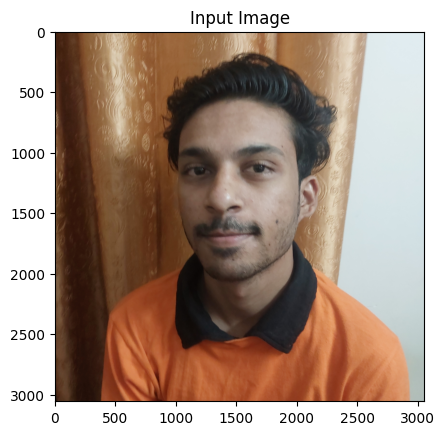

Its is Sanket photo


In [140]:
image = cv2.imread("/kaggle/input/train-test-combine/TestCombine/20240413_230100_020.jpg")
plt.title("Input Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()
ClassifyImage(image)

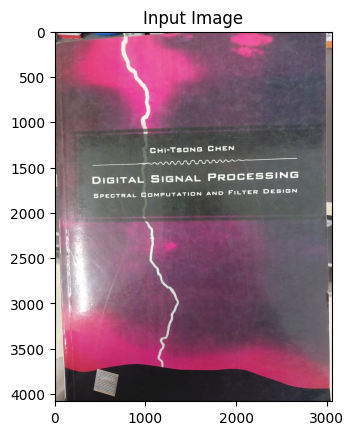

Outlier Detected


In [141]:
image = cv2.imread("/kaggle/input/imagesforq3/Q3/RandomImages100/20221012_171738.jpg")
plt.title("Input Image")
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()
ClassifyImage(image)